# Tiny NeRF
This is a simplied version of the method presented in *NeRF: Representing Scenes as Neural Radiance Fields for View Synthesis*

[Project Website](http://www.matthewtancik.com/nerf)

[arXiv Paper](https://arxiv.org/abs/2003.08934)

[Full Code](github.com/bmild/nerf)

Components not included in the notebook
*   5D input including view directions
*   Hierarchical Sampling



In [1]:
!pip install imageio-ffmpeg

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 26.9/26.9 MB 49.5 MB/s eta 0:00:00


In [2]:
import os, sys
import tensorflow as tf
tf.compat.v1.enable_eager_execution()

from tqdm import tqdm_notebook as tqdm
import numpy as np
import matplotlib.pyplot as plt

In [3]:
if not os.path.exists('tiny_nerf_data.npz'):
    !wget http://cseweb.ucsd.edu/~viscomp/projects/LF/papers/ECCV20/nerf/tiny_nerf_data.npz

--2024-01-17 11:59:52--  http://cseweb.ucsd.edu/~viscomp/projects/LF/papers/ECCV20/nerf/tiny_nerf_data.npz
Resolving cseweb.ucsd.edu (cseweb.ucsd.edu)... 132.239.8.30
Connecting to cseweb.ucsd.edu (cseweb.ucsd.edu)|132.239.8.30|:80... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://cseweb.ucsd.edu//~viscomp/projects/LF/papers/ECCV20/nerf/tiny_nerf_data.npz [following]
--2024-01-17 11:59:52--  https://cseweb.ucsd.edu//~viscomp/projects/LF/papers/ECCV20/nerf/tiny_nerf_data.npz
Connecting to cseweb.ucsd.edu (cseweb.ucsd.edu)|132.239.8.30|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 12727482 (12M)
Saving to: ‘tiny_nerf_data.npz’

tiny_nerf_data.npz  100%[===================>]  12.14M  8.50MB/s    in 1.4s    

2024-01-17 11:59:55 (8.50 MB/s) - ‘tiny_nerf_data.npz’ saved [12727482/12727482]



# Load Input Images and Poses

(106, 100, 100, 3) (106, 4, 4) 138.88887889922103


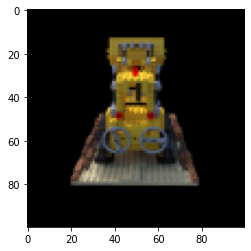

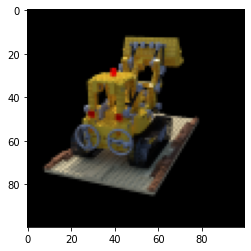

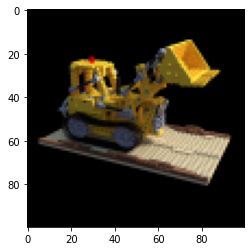

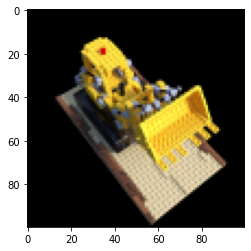

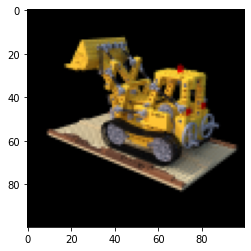

...

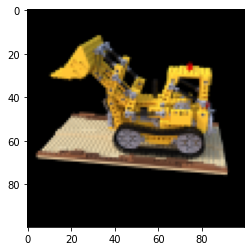

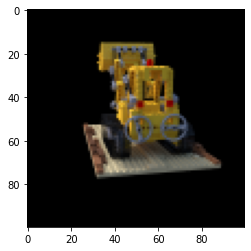

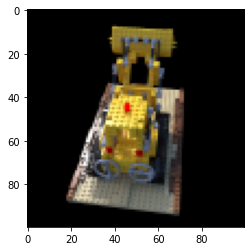

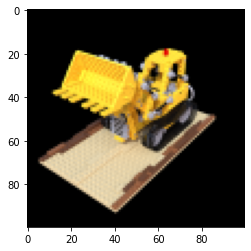

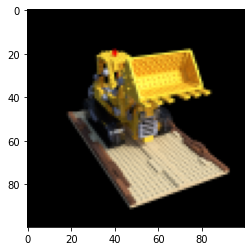

In [4]:
data = np.load('tiny_nerf_data.npz')
images = data['images']
poses = data['poses']
focal = data['focal']
H, W = images.shape[1:3]
print(images.shape, poses.shape, focal)

testimg, testpose = images[101], poses[101]
images = images[:100,...,:3]
poses = poses[:100]
for i in range(30):
    plt.figure()
    plt.imshow(images[i])
    plt.show()

# Optimize NeRF

In [5]:
def posenc(x):
  rets = [x]
  for i in range(L_embed):
    for fn in [tf.sin, tf.cos]:
      rets.append(fn(2.**i * x))
  return tf.concat(rets, -1)

L_embed = 6
embed_fn = posenc
# L_embed = 0
# embed_fn = tf.identity

def init_model(D=8, W=256):
    relu = tf.keras.layers.ReLU()    
    dense = lambda W=W, act=relu : tf.keras.layers.Dense(W, activation=act)

    inputs = tf.keras.Input(shape=(3 + 3*2*L_embed)) 
    outputs = inputs
    for i in range(D):
        outputs = dense()(outputs)
        if i%4==0 and i>0:
            outputs = tf.concat([outputs, inputs], -1)
    outputs = dense(4, act=None)(outputs)
    
    model = tf.keras.Model(inputs=inputs, outputs=outputs)
    return model


def get_rays(H, W, focal, c2w):
    i, j = tf.meshgrid(tf.range(W, dtype=tf.float32), tf.range(H, dtype=tf.float32), indexing='xy')
    dirs = tf.stack([(i-W*.5)/focal, -(j-H*.5)/focal, -tf.ones_like(i)], -1)
    rays_d = tf.reduce_sum(dirs[..., np.newaxis, :] * c2w[:3,:3], -1)
    rays_o = tf.broadcast_to(c2w[:3,-1], tf.shape(rays_d))
    return rays_o, rays_d

def render_rays(network_fn, rays_o, rays_d, near, far, N_samples, rand=False):

    def batchify(fn, chunk=1024*32):
        return lambda inputs : tf.concat([fn(inputs[i:i+chunk]) for i in range(0, inputs.shape[0], chunk)], 0)
    
    # Compute 3D query points
    z_vals = tf.linspace(near, far, N_samples) 
    if rand:
      z_vals += tf.random.uniform(list(rays_o.shape[:-1]) + [N_samples]) * (far-near)/N_samples
    pts = rays_o[...,None,:] + rays_d[...,None,:] * z_vals[...,:,None]
    
    # Run network
    pts_flat = tf.reshape(pts, [-1,3])
    pts_flat = embed_fn(pts_flat)
    raw = batchify(network_fn)(pts_flat)
    raw = tf.reshape(raw, list(pts.shape[:-1]) + [4])
    
    # Compute opacities and colors
    sigma_a = tf.nn.relu(raw[...,3])
    rgb = tf.math.sigmoid(raw[...,:3]) 
    
    # Do volume rendering
    dists = tf.concat([z_vals[..., 1:] - z_vals[..., :-1], tf.broadcast_to([1e10], z_vals[...,:1].shape)], -1) 
    alpha = 1.-tf.exp(-sigma_a * dists)  
    weights = alpha * tf.math.cumprod(1.-alpha + 1e-10, -1, exclusive=True)
    
    rgb_map = tf.reduce_sum(weights[...,None] * rgb, -2) 
    depth_map = tf.reduce_sum(weights * z_vals, -1) 
    acc_map = tf.reduce_sum(weights, -1)

    return rgb_map, depth_map, acc_map

Here we optimize the model. We plot a rendered holdout view and its PSNR every 50 iterations.

0 0.05664799690246582 secs per iter


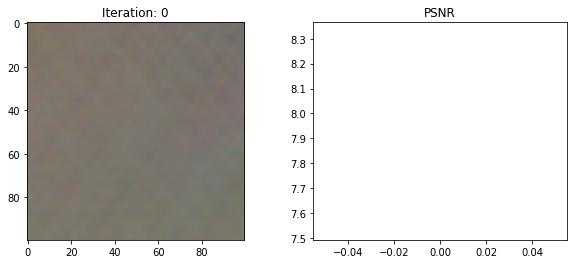

25 0.4558104610443115 secs per iter


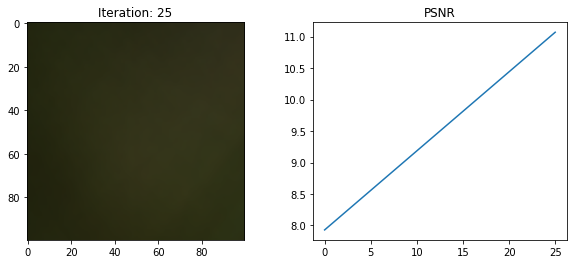

50 0.4640388011932373 secs per iter


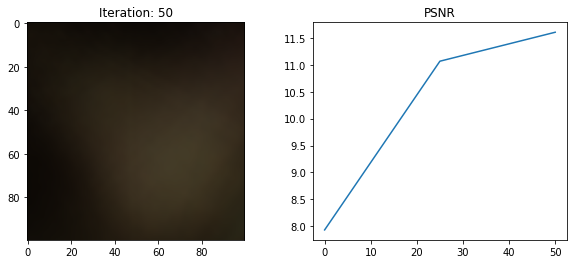

75 0.4606757068634033 secs per iter


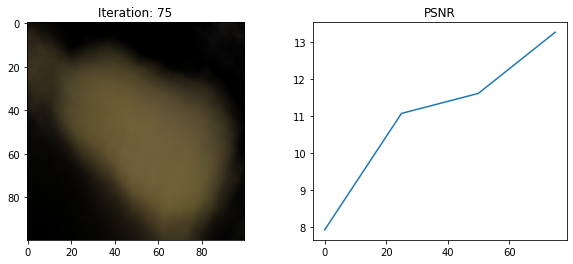

100 0.4625728607177734 secs per iter


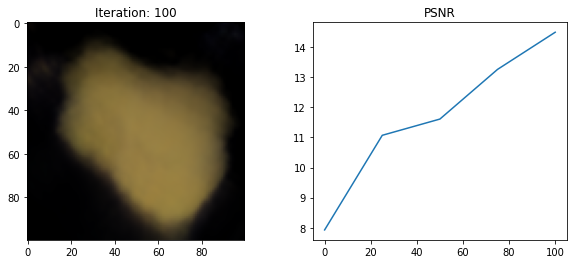

125 0.46010616302490237 secs per iter


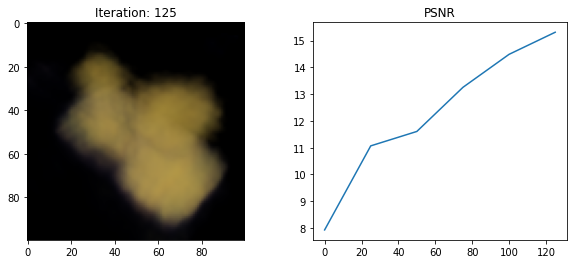

150 0.46405461311340335 secs per iter


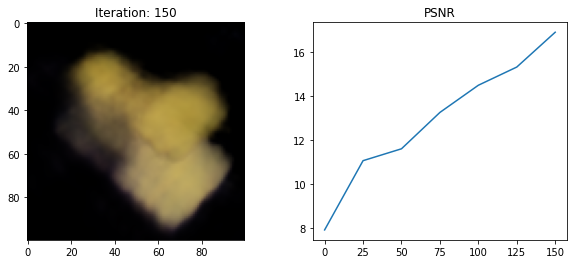

175 0.4626315498352051 secs per iter


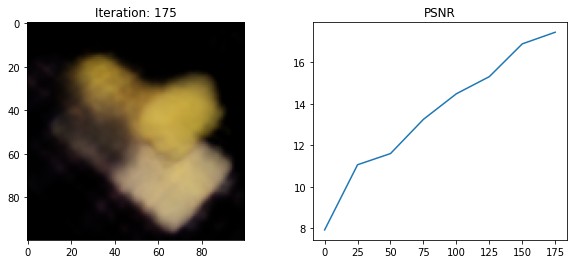

200 0.46353682518005374 secs per iter


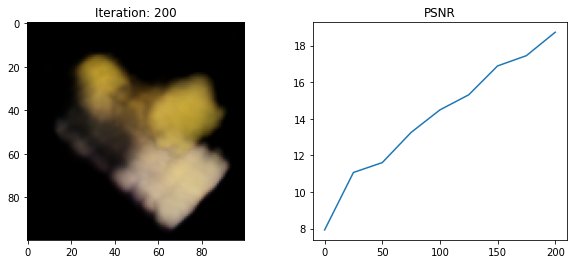

225 0.4697207260131836 secs per iter


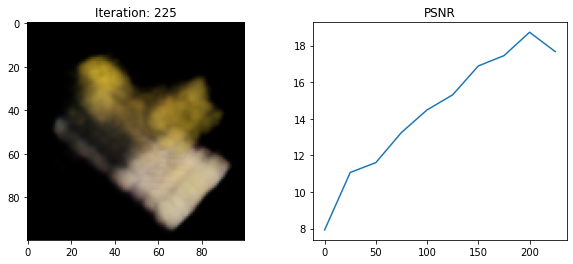

250 0.460449161529541 secs per iter


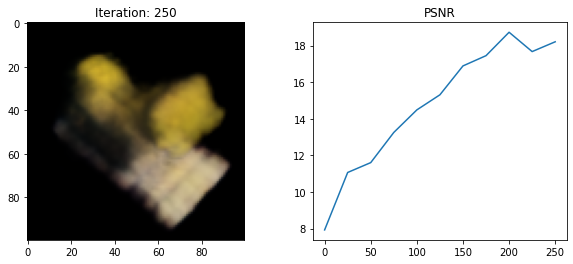

275 0.4609647655487061 secs per iter


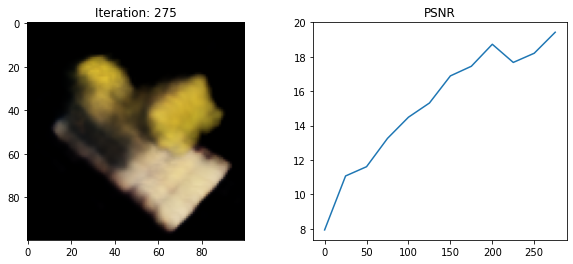

300 0.46381564140319825 secs per iter


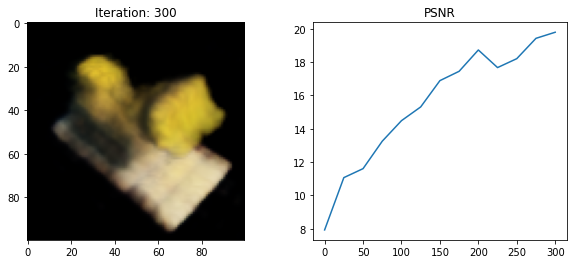

325 0.46426680564880374 secs per iter


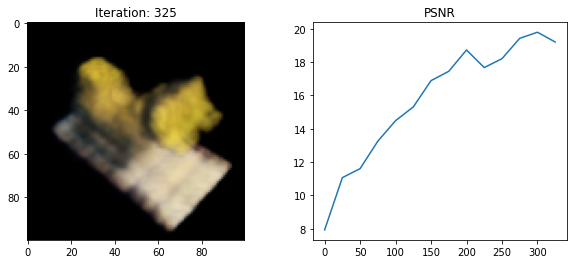

350 0.45848654747009276 secs per iter


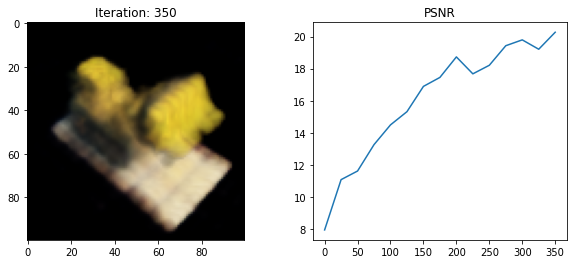

375 0.46174261093139646 secs per iter


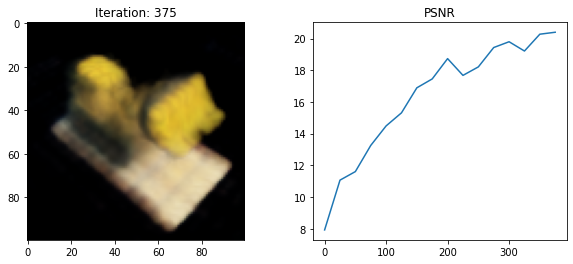

400 0.46053568840026854 secs per iter


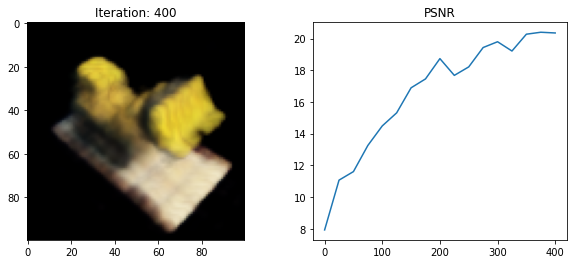

425 0.4609012794494629 secs per iter


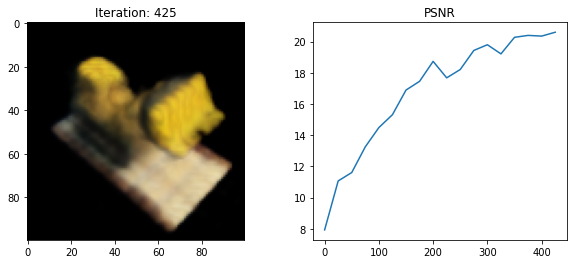

450 0.4634050273895264 secs per iter


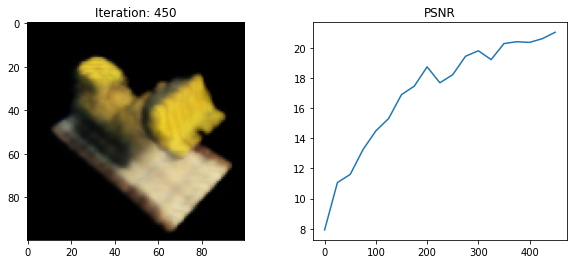

475 0.4599381637573242 secs per iter


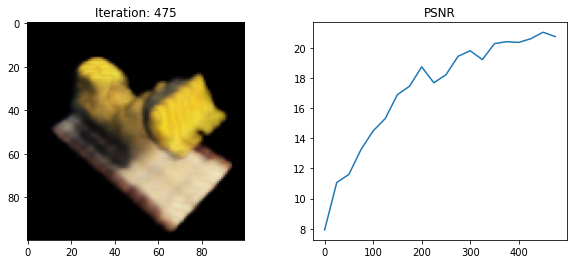

500 0.45819281578063964 secs per iter


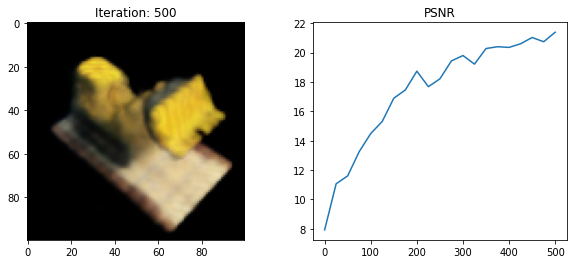

525 0.462862548828125 secs per iter


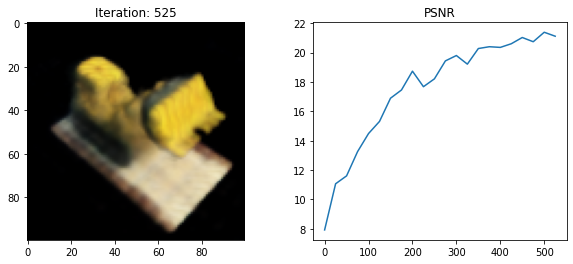

550 0.46931798934936525 secs per iter


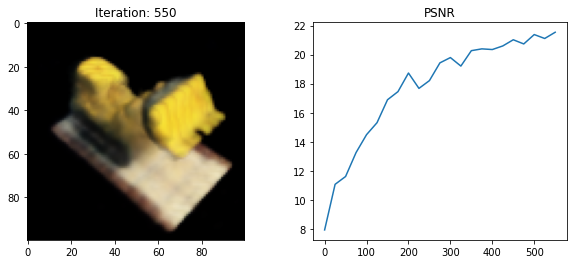

575 0.4631525135040283 secs per iter


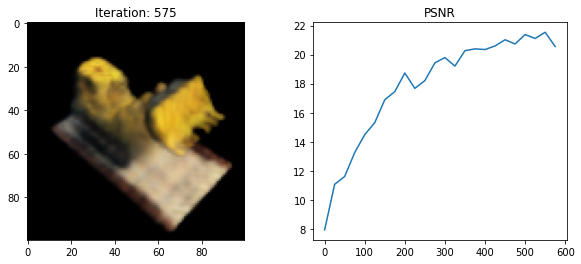

600 0.4608925819396973 secs per iter


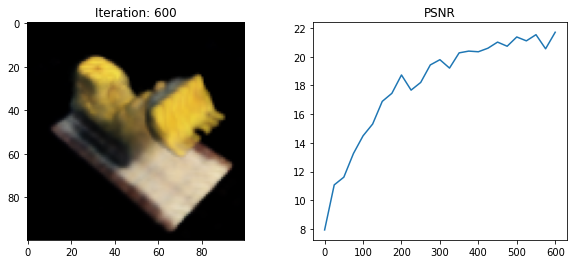

625 0.46396488189697266 secs per iter


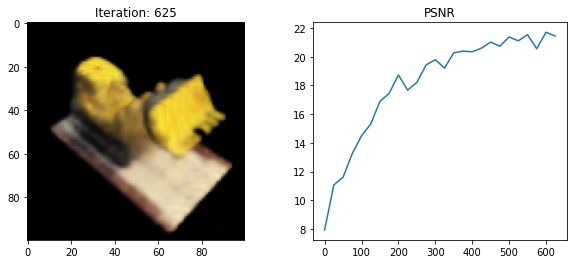

650 0.46157332420349123 secs per iter


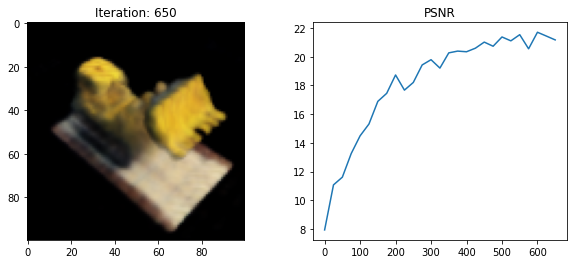

675 0.45963233947753906 secs per iter


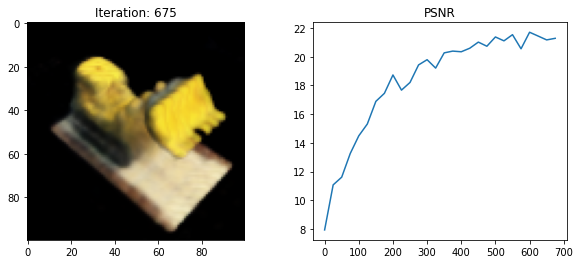

700 0.46010814666748046 secs per iter


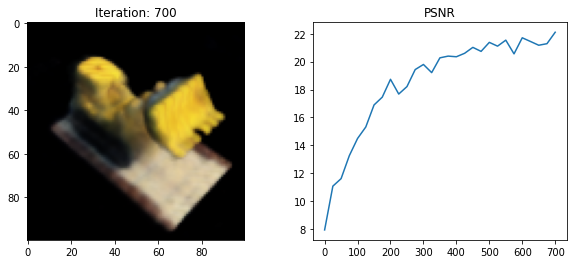

725 0.463226900100708 secs per iter


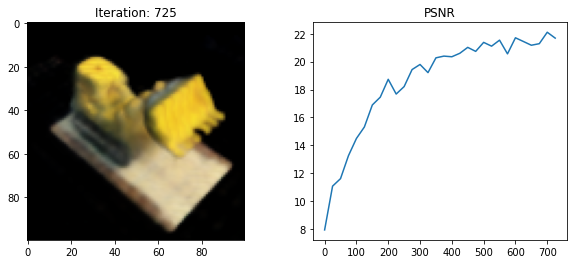

750 0.45877531051635745 secs per iter


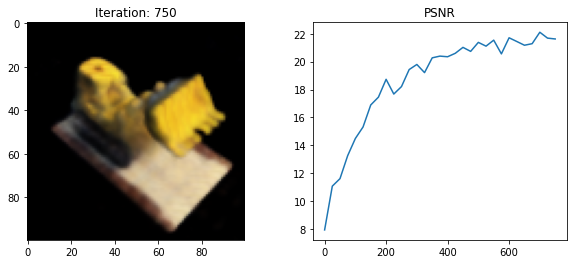

775 0.4623469924926758 secs per iter


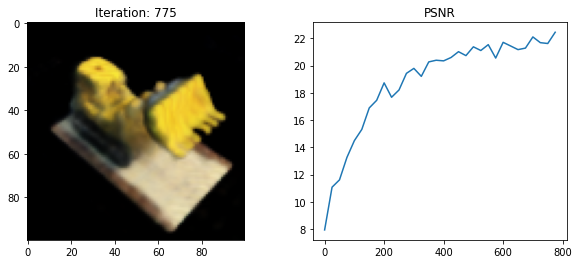

800 0.46553385734558106 secs per iter


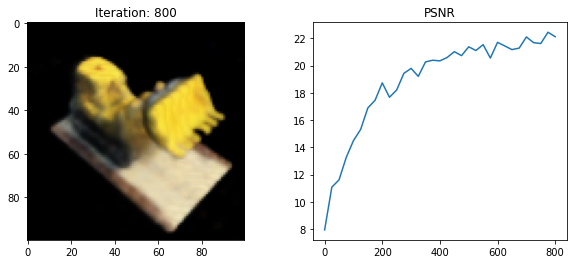

825 0.46391303062438966 secs per iter


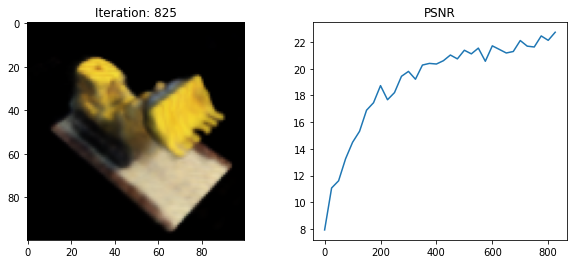

850 0.4680444145202637 secs per iter


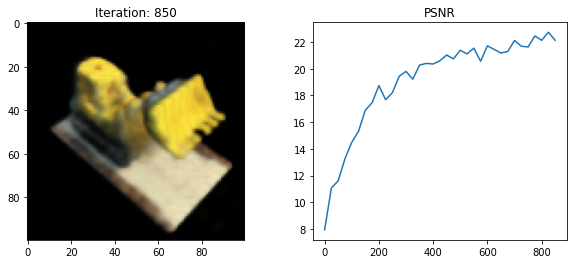

875 0.4620705699920654 secs per iter


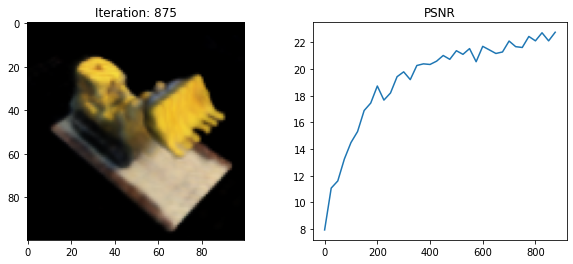

900 0.4611335563659668 secs per iter


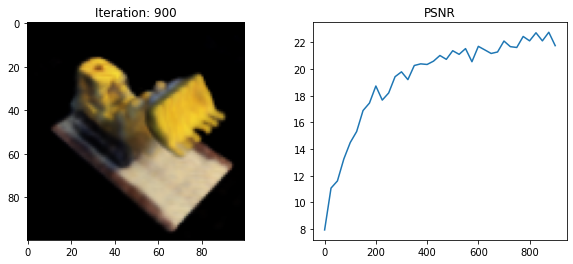

925 0.460875244140625 secs per iter


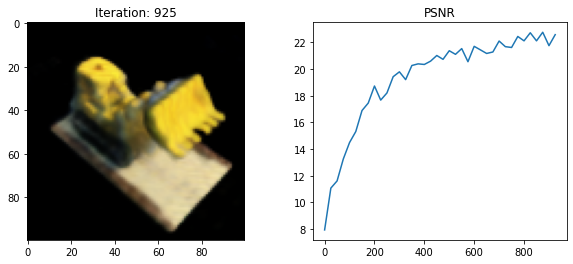

950 0.45955644607543944 secs per iter


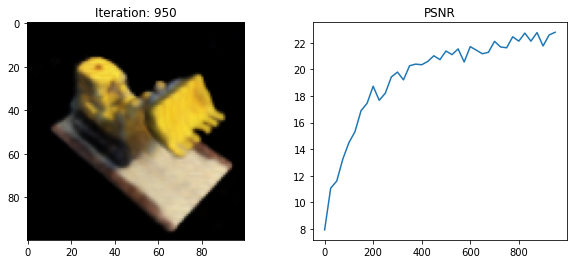

975 0.4644384574890137 secs per iter


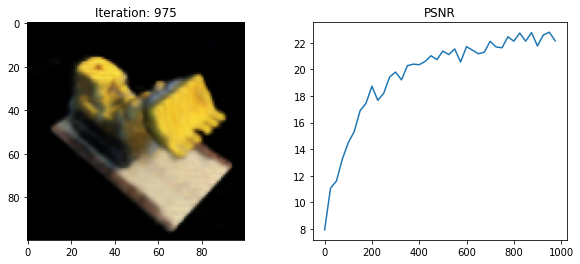

1000 0.4640704250335693 secs per iter


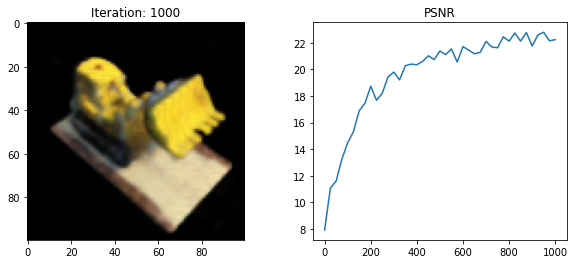

1025 0.4636702156066895 secs per iter


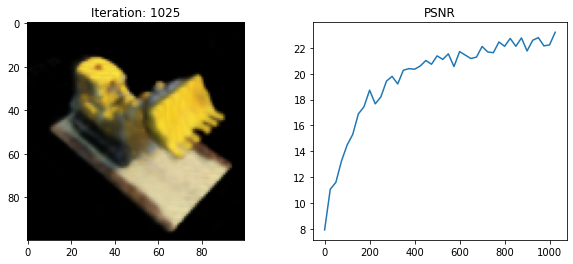

1050 0.4617376708984375 secs per iter


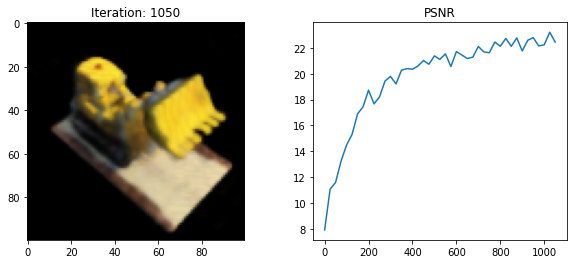

1075 0.4624887847900391 secs per iter


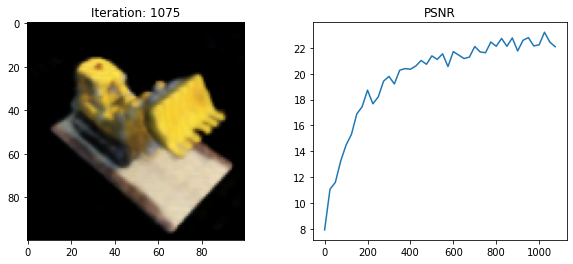

1100 0.45926657676696775 secs per iter


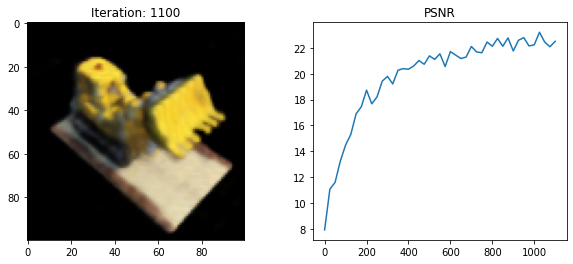

1125 0.45926140785217284 secs per iter


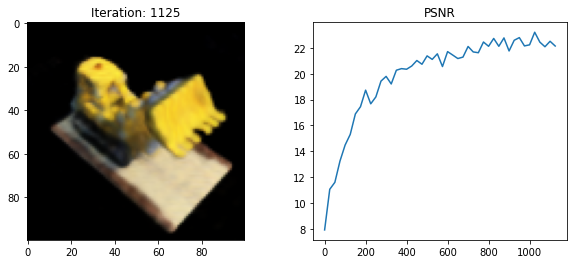

1150 0.46803988456726076 secs per iter


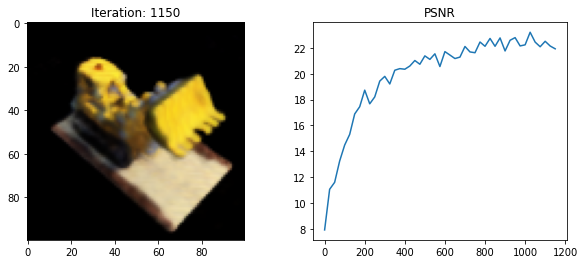

1175 0.45965325355529785 secs per iter


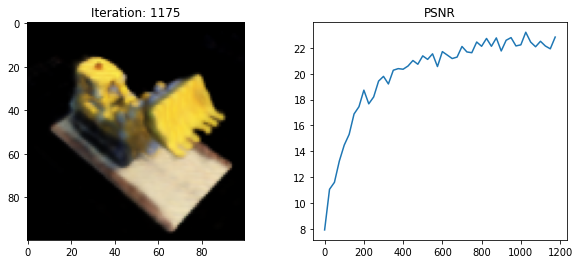

1200 0.46218106269836423 secs per iter


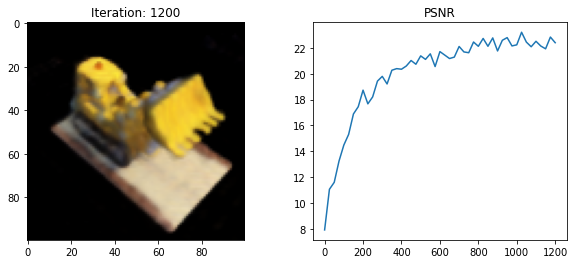

1225 0.4634440612792969 secs per iter


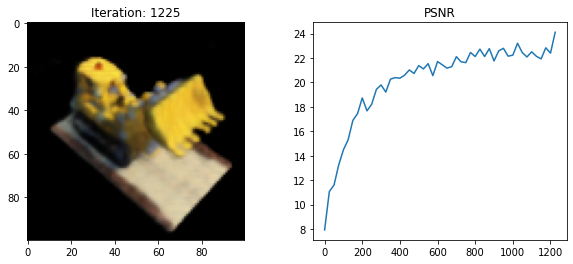

1250 0.46180983543396 secs per iter


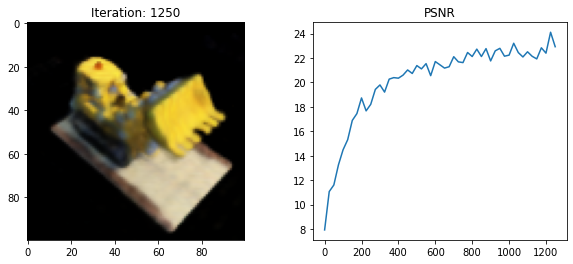

1275 0.4611312675476074 secs per iter


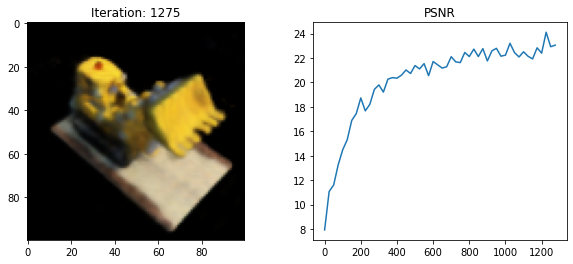

1300 0.46049275398254397 secs per iter


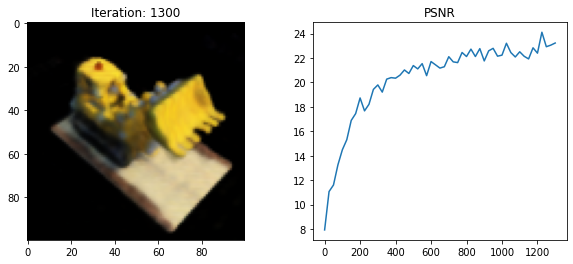

1325 0.4604578685760498 secs per iter


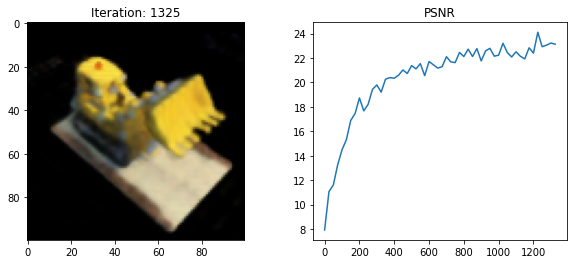

1350 0.4638567066192627 secs per iter


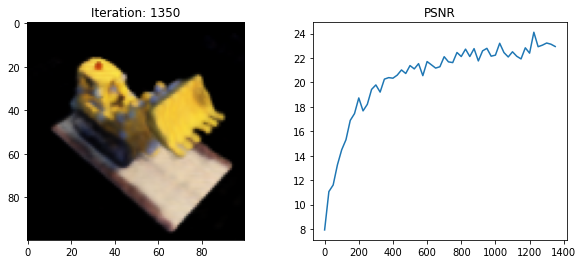

1375 0.4636924362182617 secs per iter


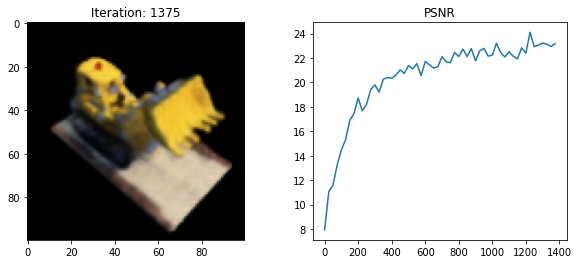

1400 0.46235386848449705 secs per iter


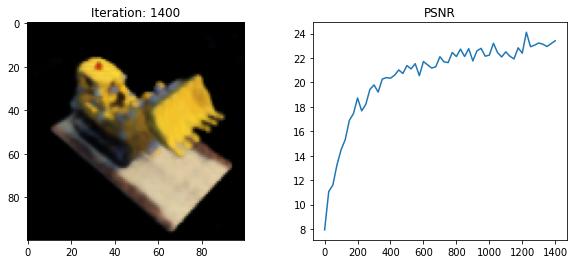

1425 0.4631613254547119 secs per iter


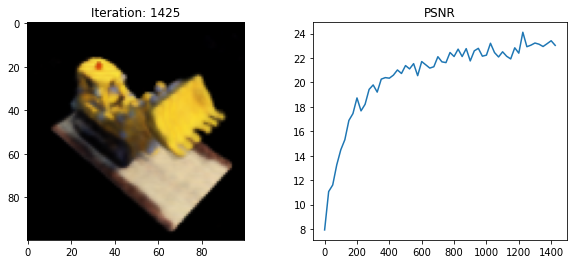

1450 0.4686343860626221 secs per iter


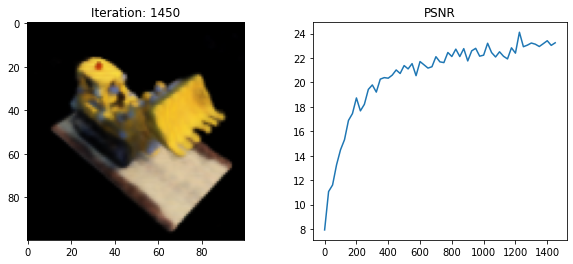

1475 0.46213814735412595 secs per iter


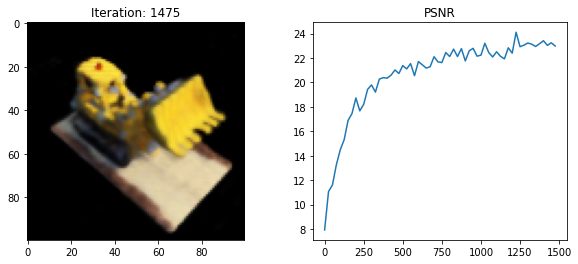

1500 0.46250985145568846 secs per iter


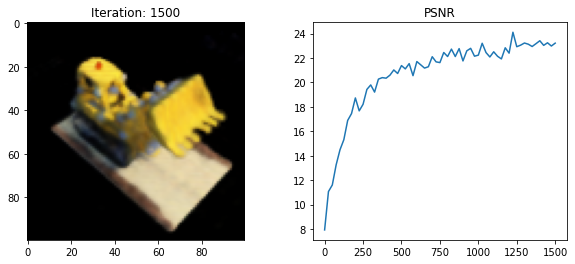

1525 0.4627365589141846 secs per iter


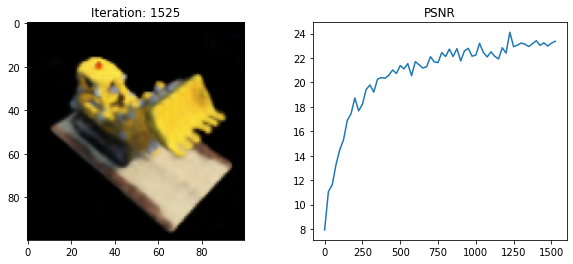

1550 0.4600216388702393 secs per iter


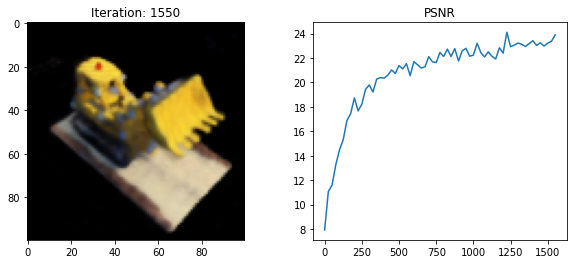

1575 0.46027055740356443 secs per iter


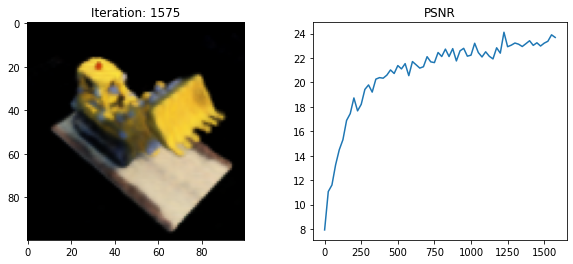

1600 0.46281936645507815 secs per iter


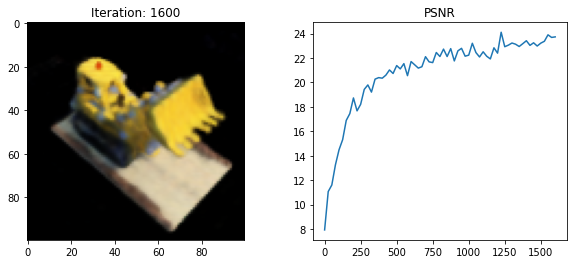

1625 0.4638644599914551 secs per iter


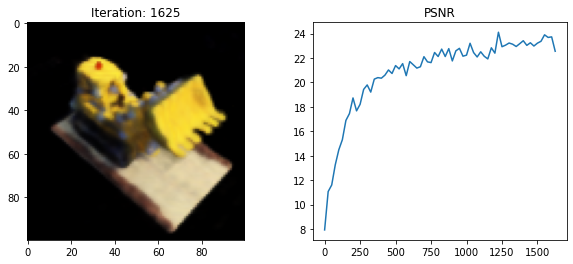

1650 0.4628729248046875 secs per iter


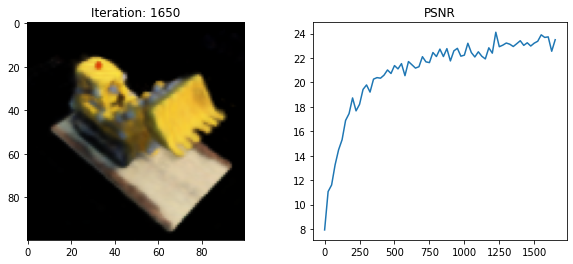

1675 0.46345425605773927 secs per iter


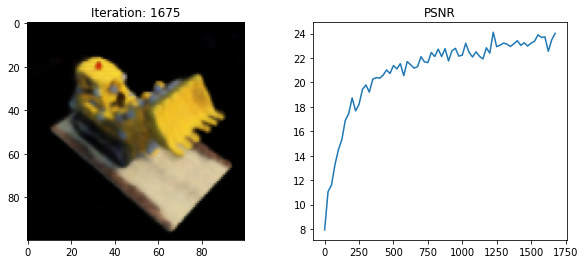

1700 0.46258304595947264 secs per iter


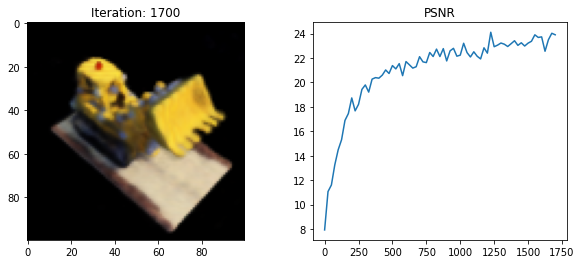

1725 0.4625238037109375 secs per iter


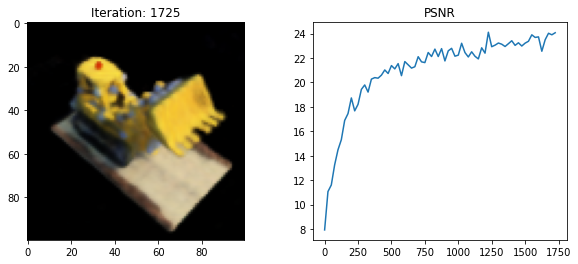

1750 0.46958609580993654 secs per iter


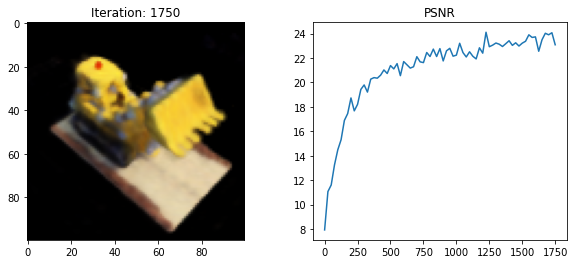

1775 0.46216569900512694 secs per iter


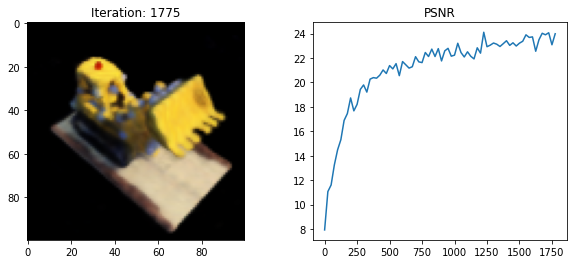

1800 0.46203324317932126 secs per iter


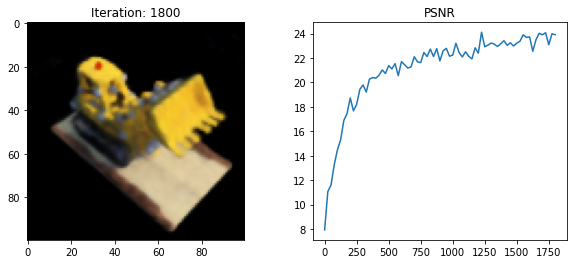

1825 0.46233209609985354 secs per iter


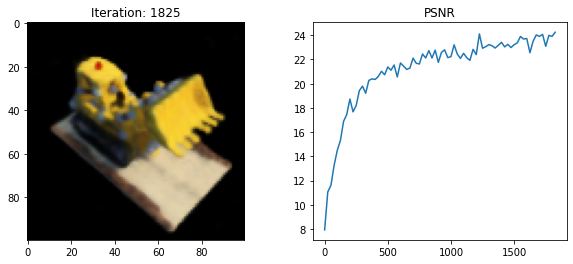

1850 0.4630362892150879 secs per iter


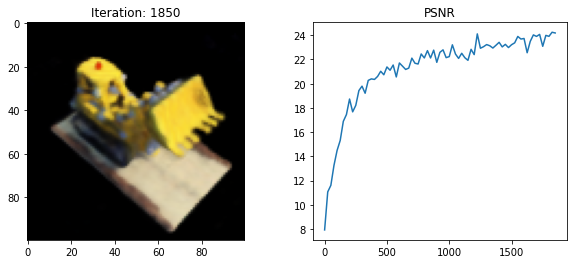

1875 0.4614211845397949 secs per iter


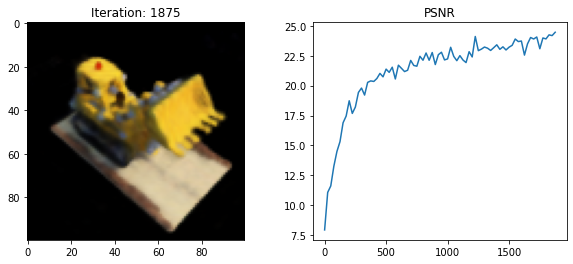

1900 0.4636108875274658 secs per iter


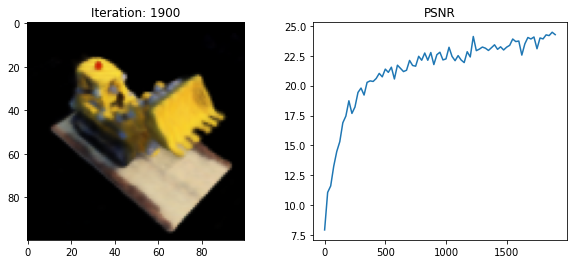

1925 0.4615541648864746 secs per iter


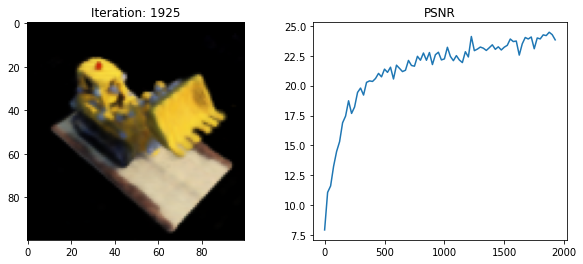

1950 0.46185877799987796 secs per iter


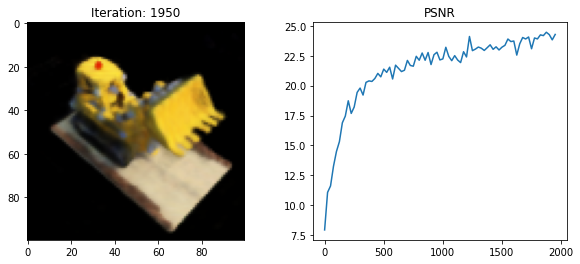

1975 0.46193547248840333 secs per iter


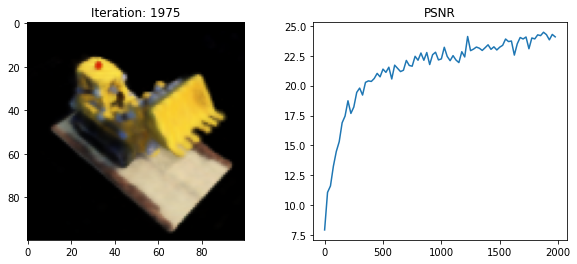

2000 0.45892882347106934 secs per iter


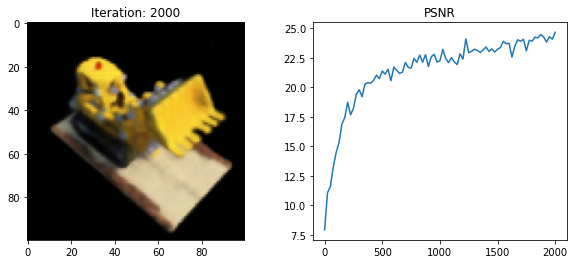

2025 0.4636226177215576 secs per iter


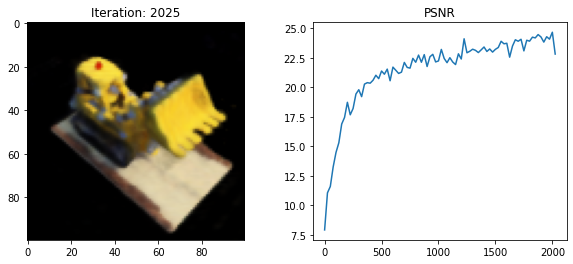

2050 0.4695752239227295 secs per iter


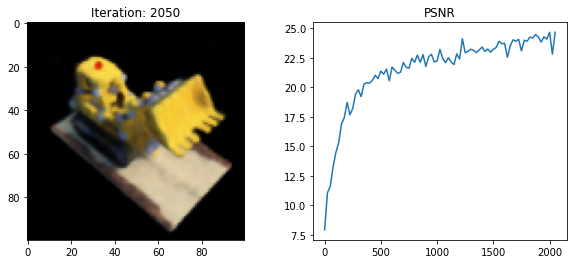

2075 0.4610277080535889 secs per iter


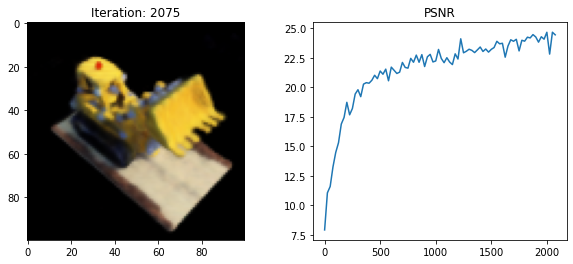

2100 0.4619471645355225 secs per iter


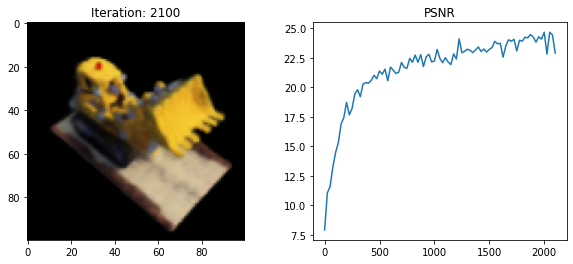

2125 0.46256165504455565 secs per iter


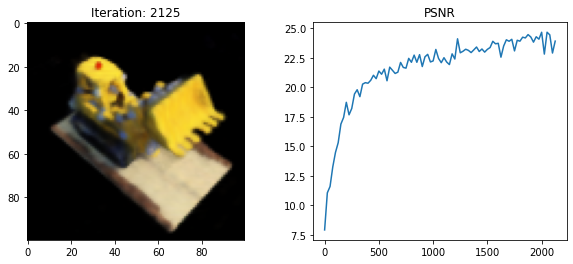

2150 0.4590018844604492 secs per iter


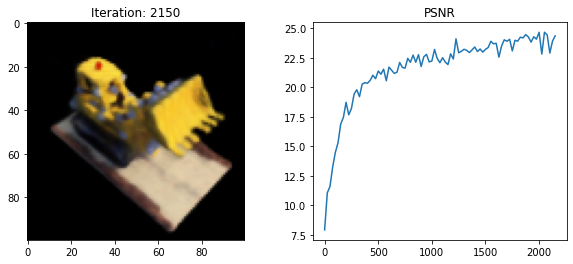

2175 0.46128676414489744 secs per iter


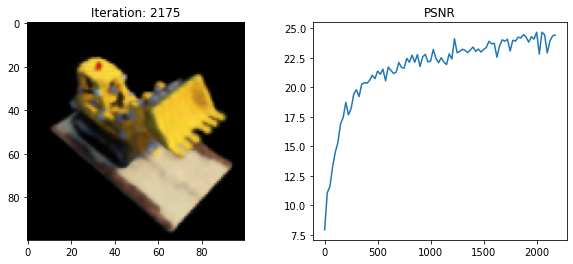

2200 0.46299991607666013 secs per iter


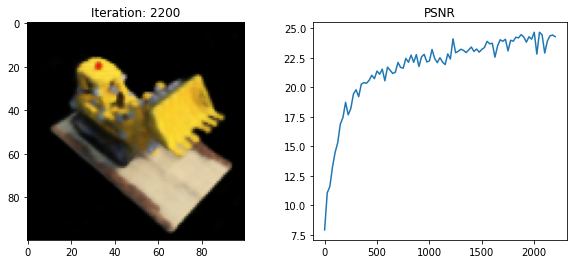

2225 0.4621767139434814 secs per iter


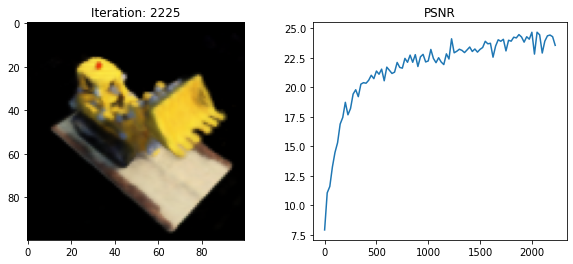

2250 0.46185014724731444 secs per iter


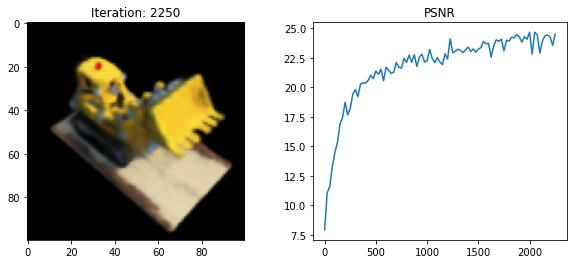

2275 0.46201156616210937 secs per iter


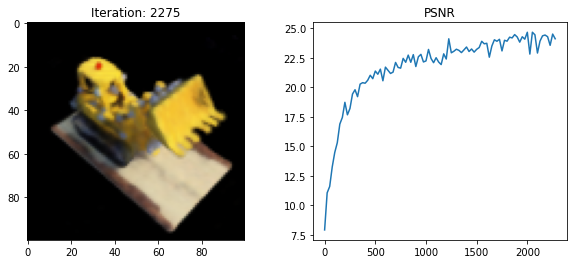

2300 0.4616185188293457 secs per iter


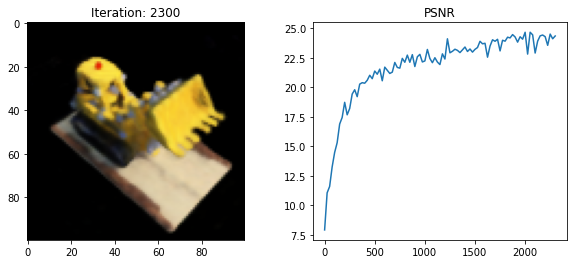

2325 0.461826868057251 secs per iter


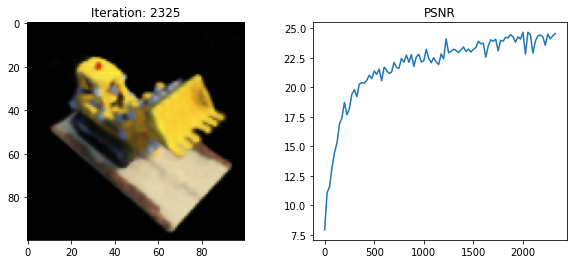

2350 0.4620439624786377 secs per iter


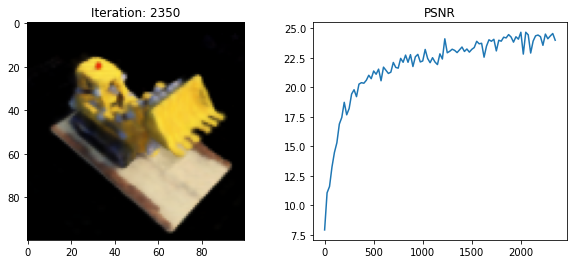

2375 0.4685889720916748 secs per iter


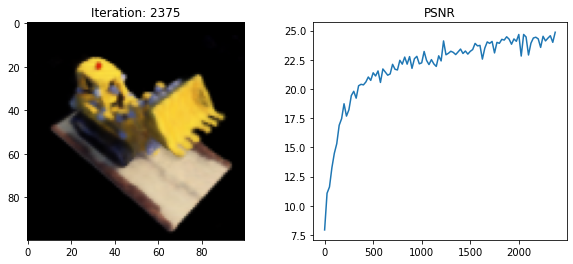

2400 0.46299549102783205 secs per iter


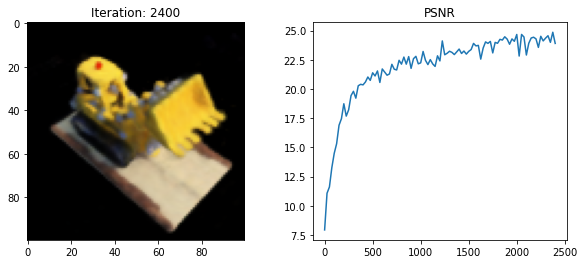

2425 0.4625967788696289 secs per iter


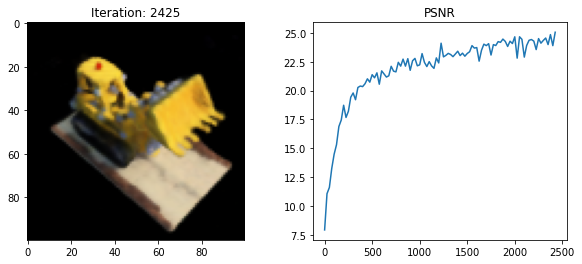

2450 0.46038816452026365 secs per iter


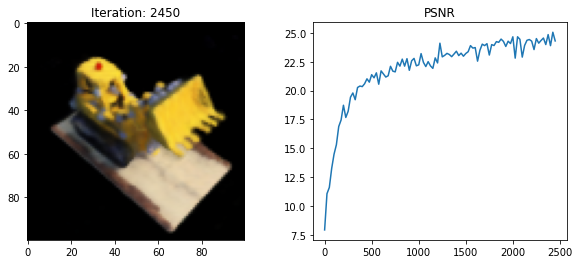

2475 0.46212479591369626 secs per iter


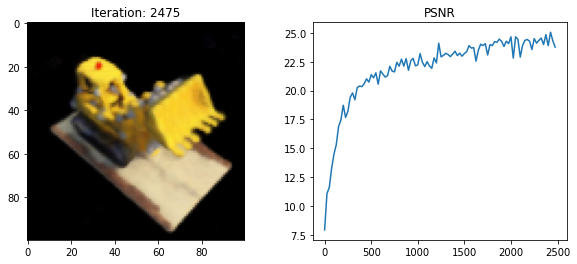

2500 0.4621728324890137 secs per iter


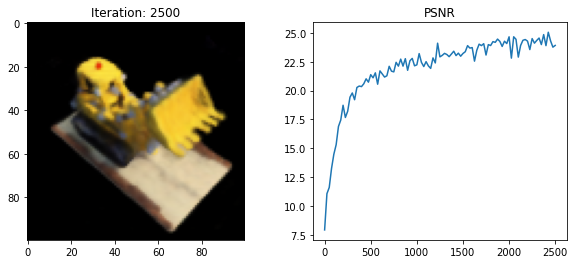

2525 0.45946276664733887 secs per iter


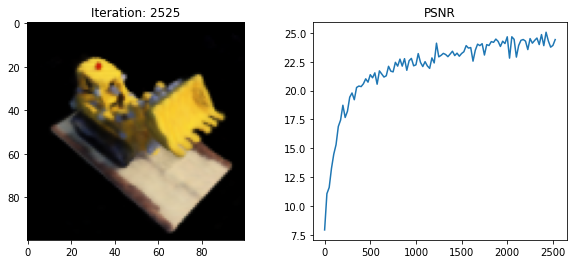

2550 0.46247038841247556 secs per iter


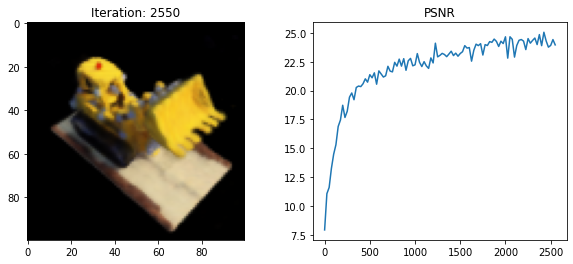

2575 0.4622560787200928 secs per iter


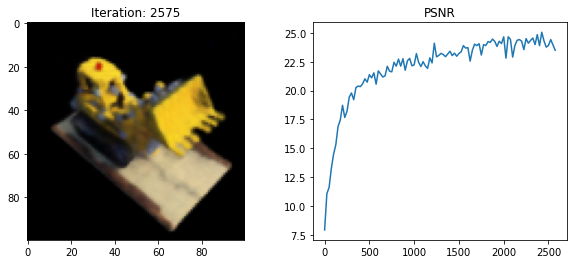

2600 0.46019003868103026 secs per iter


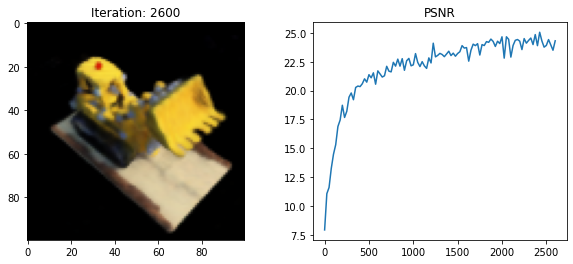

2625 0.4594154357910156 secs per iter


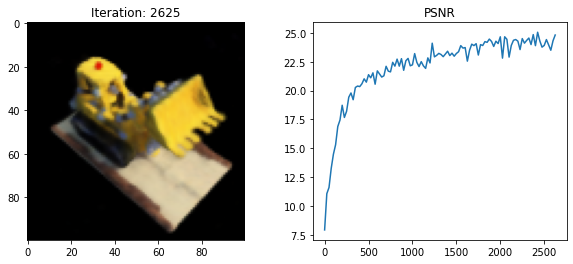

2650 0.46236515998840333 secs per iter


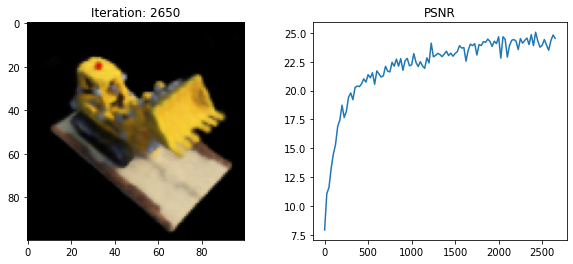

2675 0.46857285499572754 secs per iter


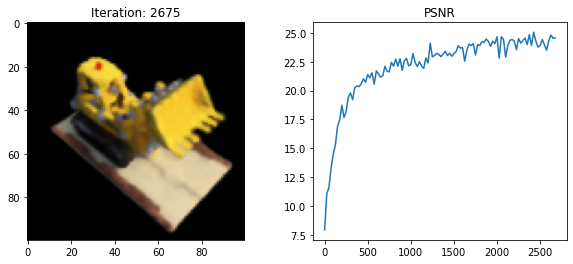

2700 0.4626827430725098 secs per iter


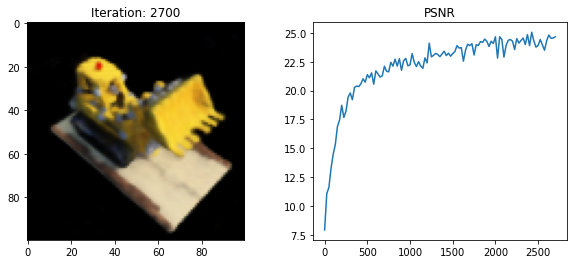

2725 0.4625870132446289 secs per iter


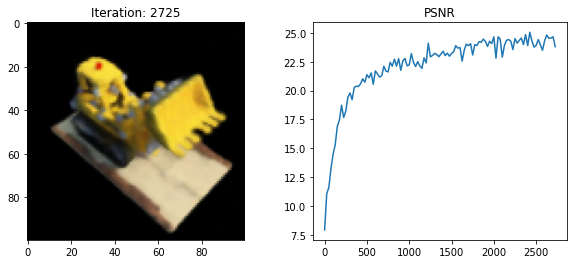

2750 0.46153860092163085 secs per iter


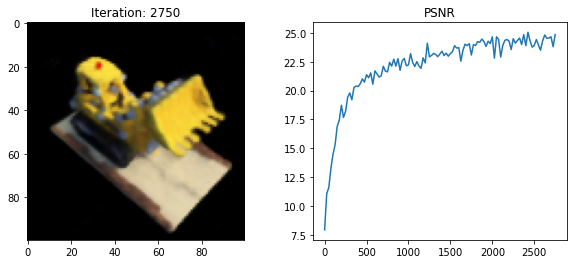

2775 0.4622445583343506 secs per iter


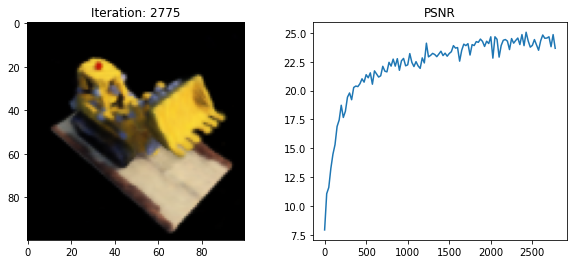

2800 0.46171040534973146 secs per iter


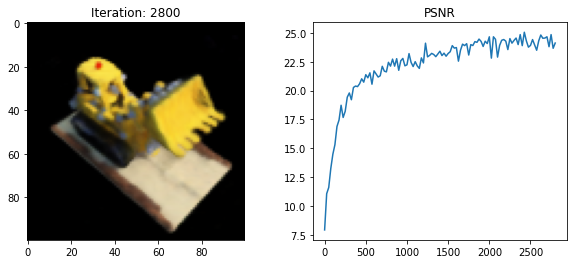

2825 0.4619192409515381 secs per iter


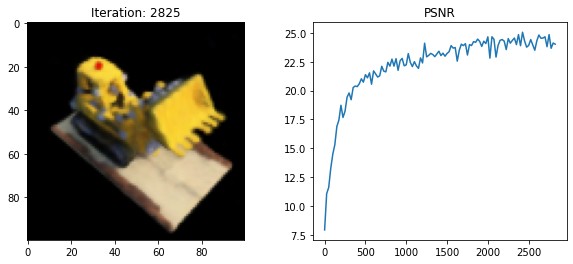

2850 0.45919270515441896 secs per iter


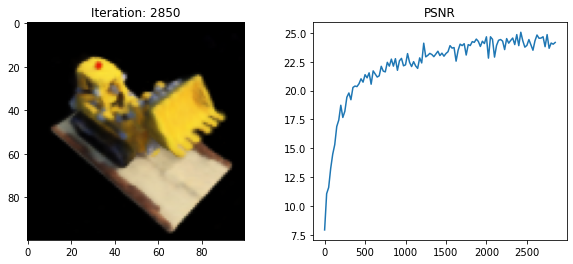

2875 0.46251774787902833 secs per iter


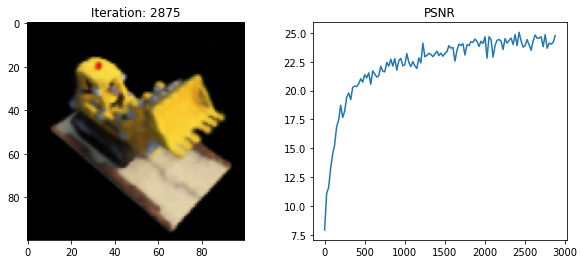

2900 0.4637263679504395 secs per iter


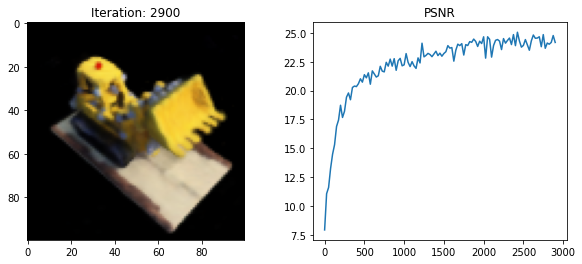

2925 0.4617927646636963 secs per iter


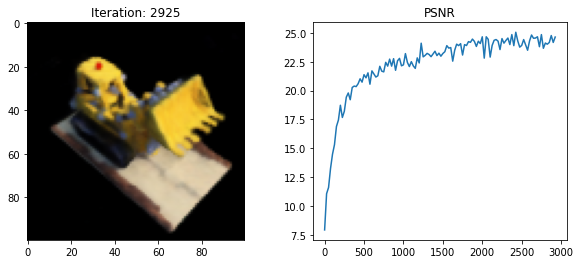

2950 0.46191667556762694 secs per iter


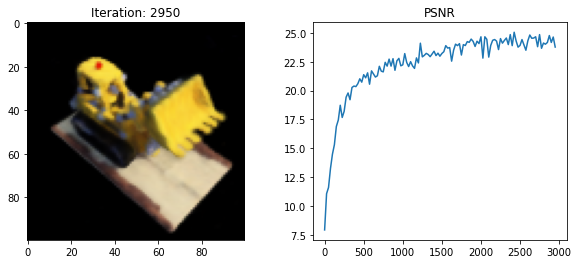

2975 0.46558327674865724 secs per iter


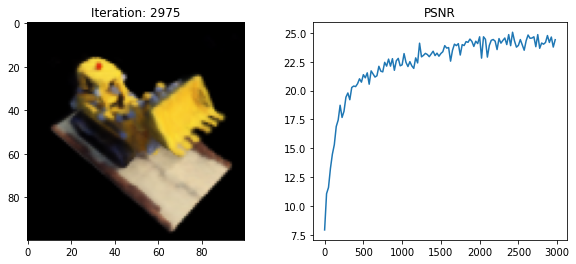

3000 0.46156996726989746 secs per iter


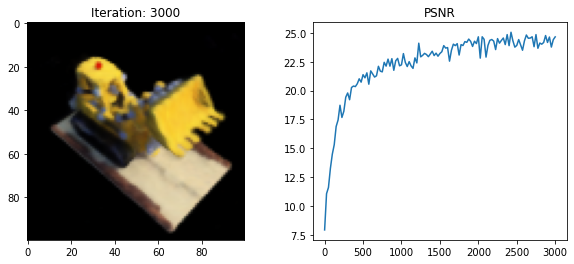

3025 0.4642516708374023 secs per iter


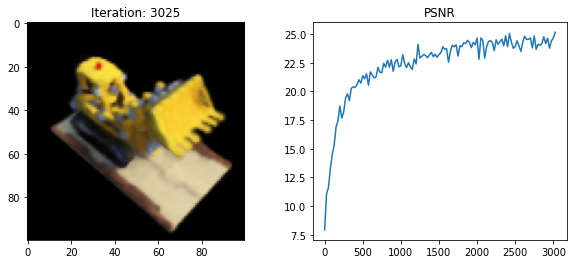

3050 0.463366813659668 secs per iter


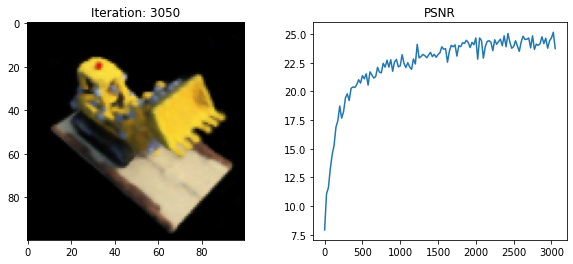

3075 0.46248515129089357 secs per iter


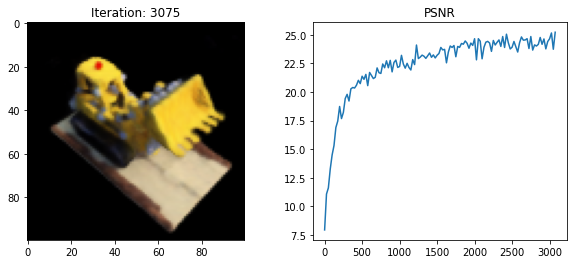

3100 0.4636916923522949 secs per iter


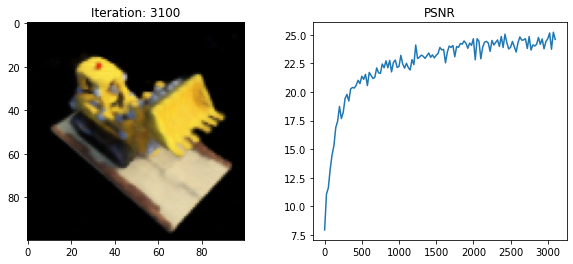

3125 0.462263879776001 secs per iter


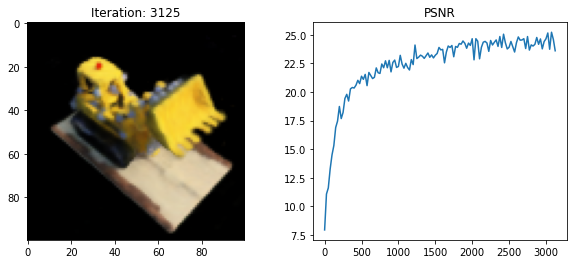

3150 0.45997894287109375 secs per iter


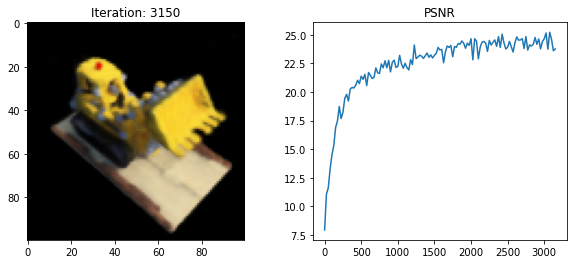

3175 0.4620532989501953 secs per iter


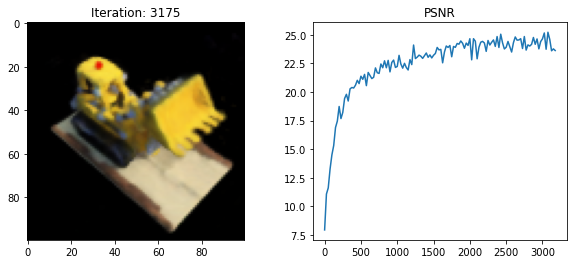

3200 0.46192476272583005 secs per iter


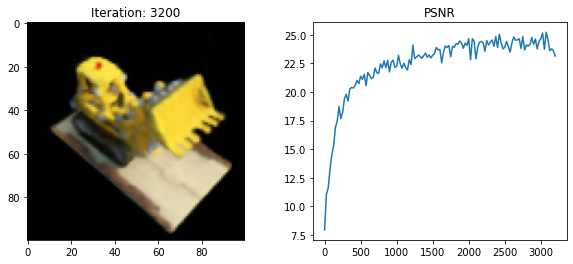

3225 0.45961058616638184 secs per iter


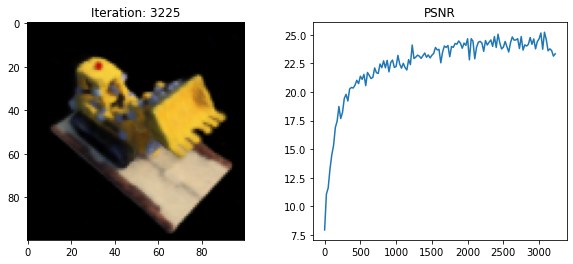

3250 0.4624127769470215 secs per iter


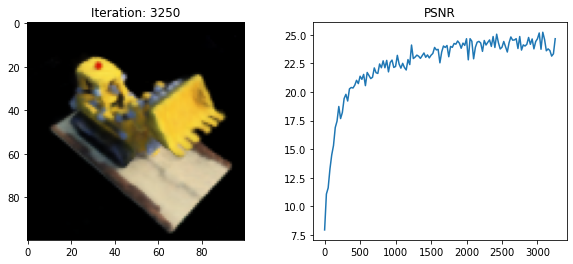

3275 0.4688528442382813 secs per iter


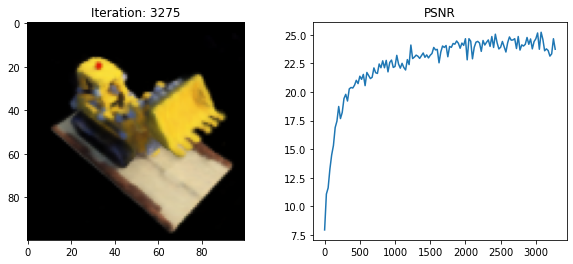

3300 0.4624510860443115 secs per iter


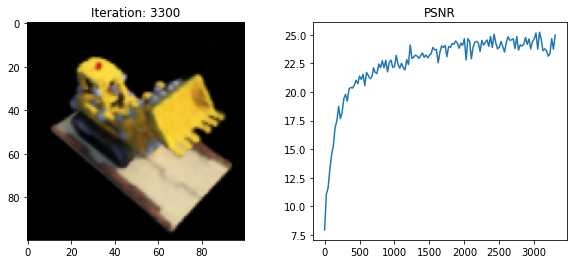

3325 0.4622206115722656 secs per iter


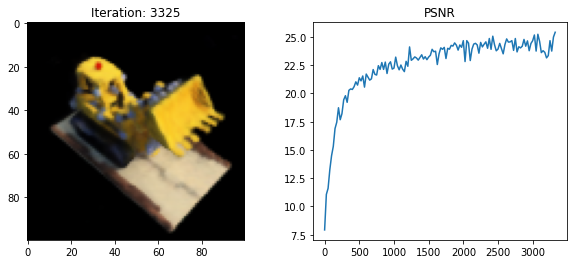

3350 0.4639130210876465 secs per iter


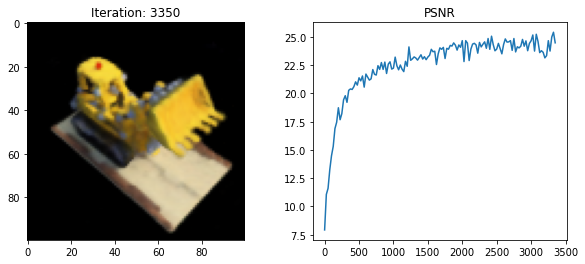

3375 0.46189781188964846 secs per iter


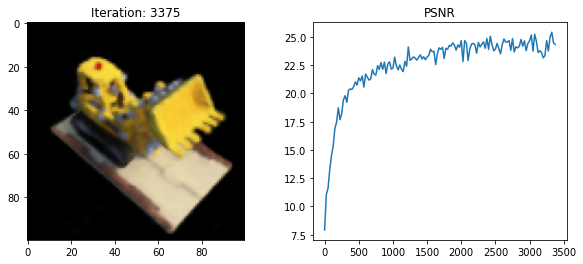

3400 0.46239217758178713 secs per iter


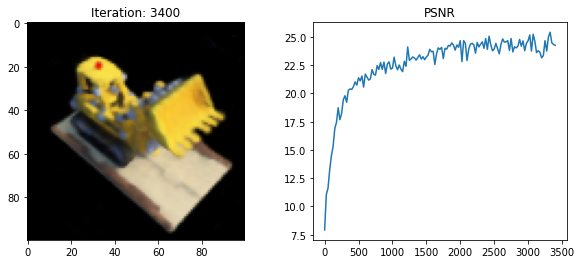

3425 0.4628041362762451 secs per iter


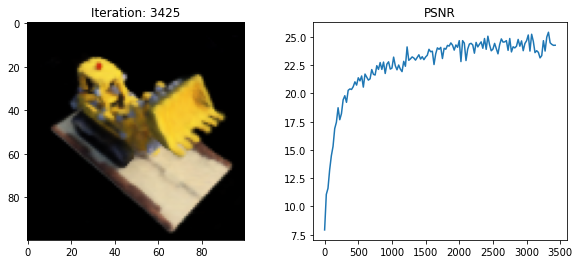

3450 0.4620560836791992 secs per iter


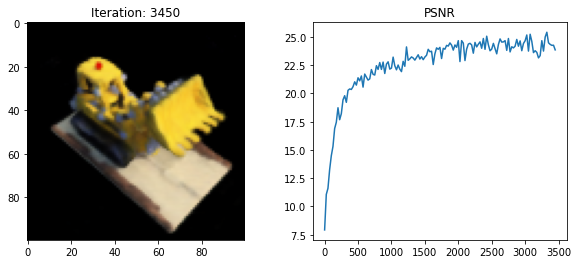

3475 0.4631230640411377 secs per iter


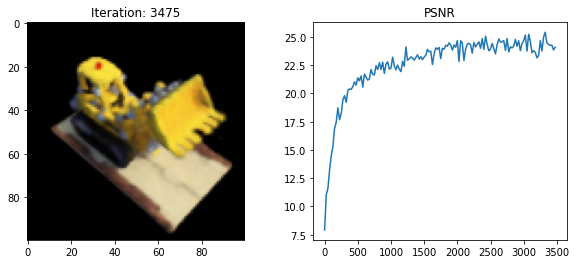

3500 0.4626078701019287 secs per iter


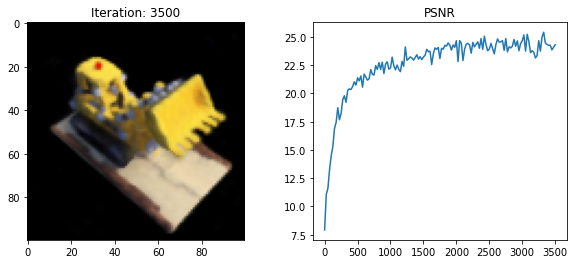

3525 0.46261622428894045 secs per iter


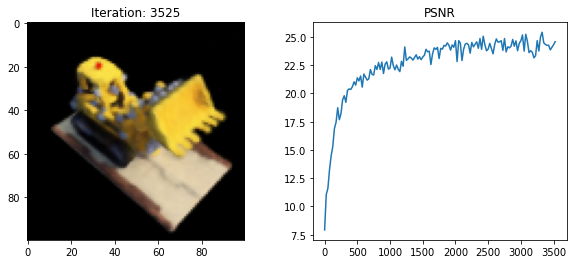

3550 0.4638557147979736 secs per iter


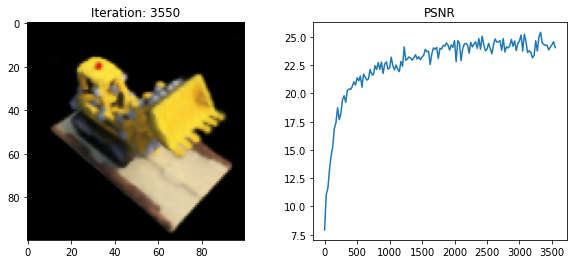

3575 0.47187410354614256 secs per iter


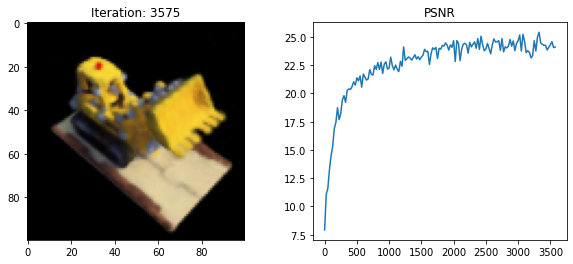

3600 0.4640408229827881 secs per iter


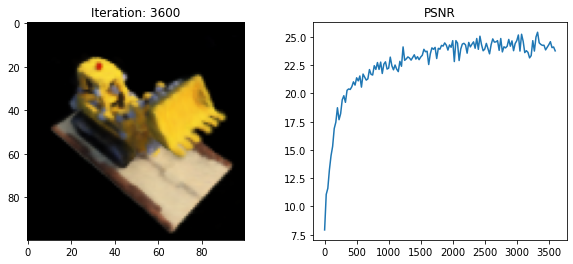

3625 0.4641903305053711 secs per iter


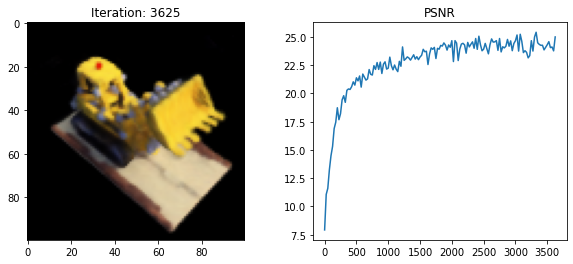

3650 0.4606681537628174 secs per iter


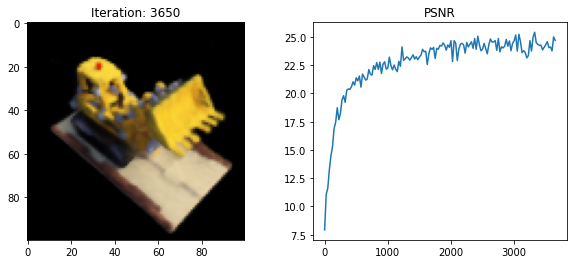

3675 0.4637704086303711 secs per iter


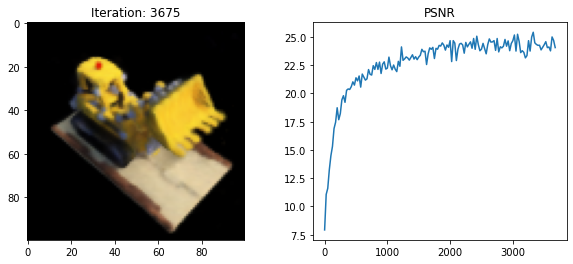

3700 0.4628024768829346 secs per iter


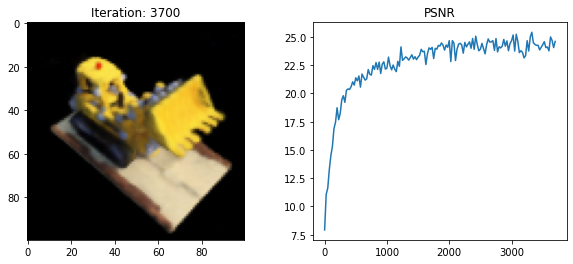

3725 0.4627531051635742 secs per iter


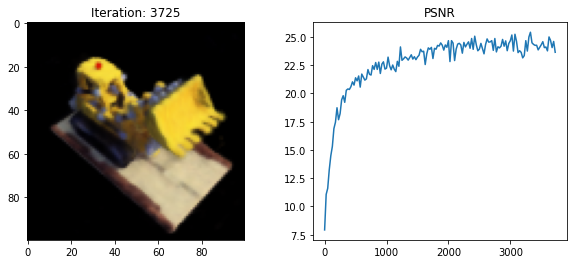

3750 0.46372249603271487 secs per iter


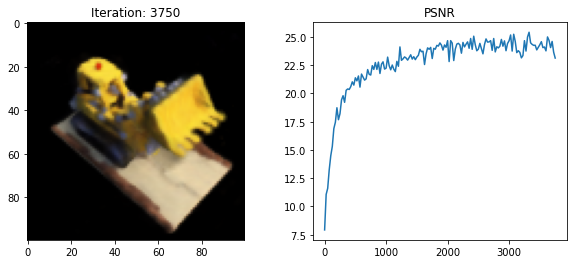

3775 0.4639726638793945 secs per iter


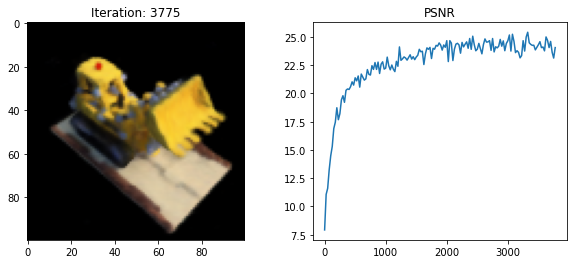

3800 0.4629728889465332 secs per iter


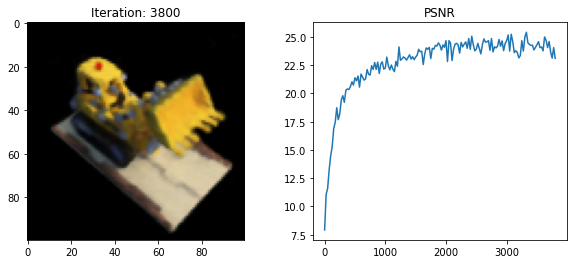

3825 0.4626151180267334 secs per iter


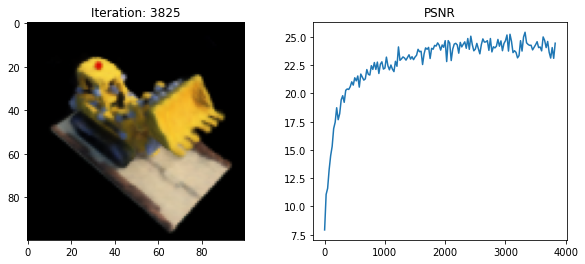

3850 0.46292312622070314 secs per iter


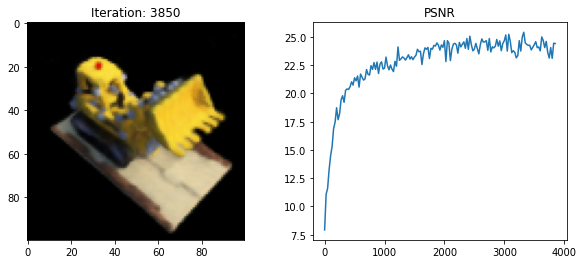

3875 0.46267602920532225 secs per iter


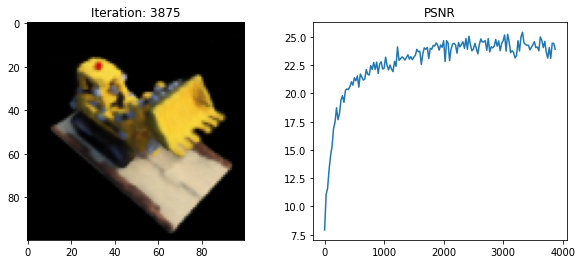

3900 0.46998908042907717 secs per iter


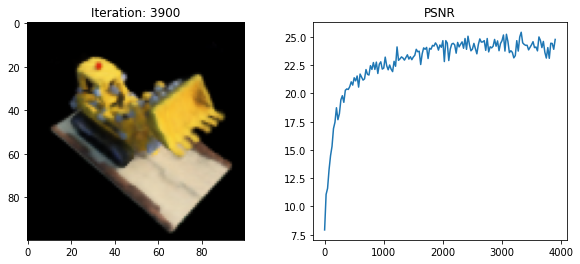

3925 0.462537088394165 secs per iter


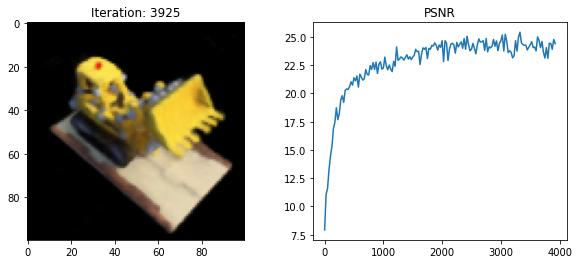

3950 0.46260910034179686 secs per iter


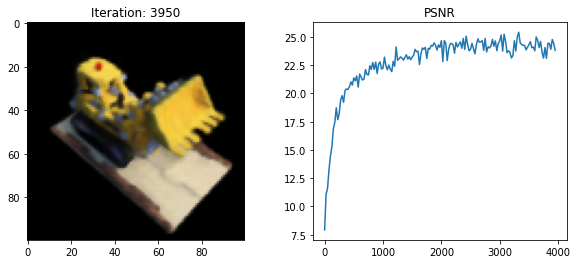

3975 0.4628719711303711 secs per iter


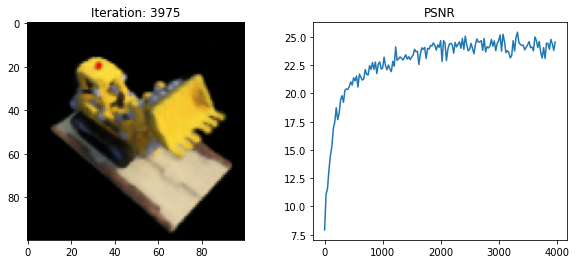

4000 0.4624346923828125 secs per iter


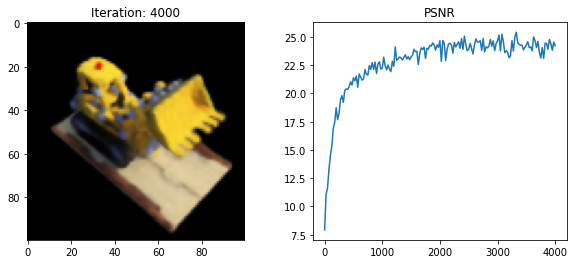

4025 0.46207623481750487 secs per iter


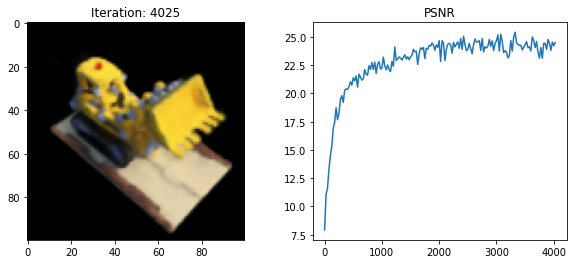

4050 0.46362189292907713 secs per iter


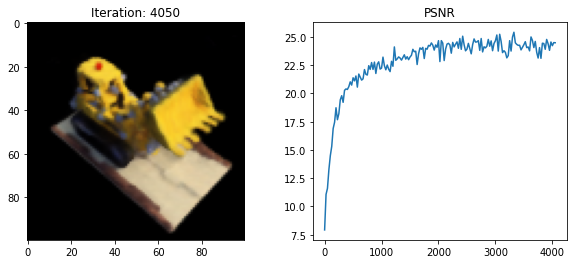

4075 0.4635611343383789 secs per iter


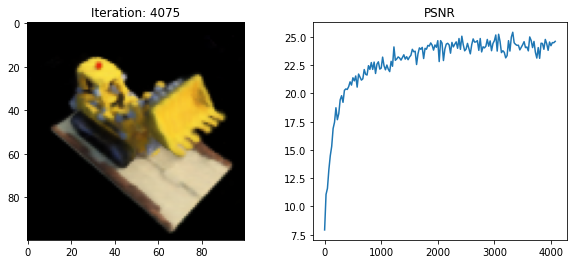

4100 0.46334787368774416 secs per iter


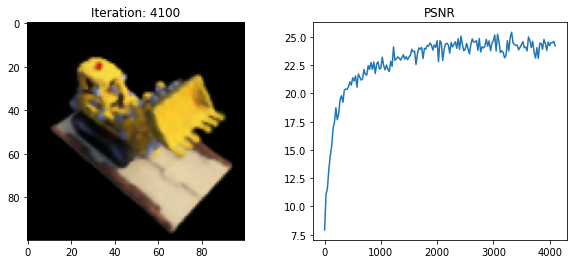

4125 0.4633466148376465 secs per iter


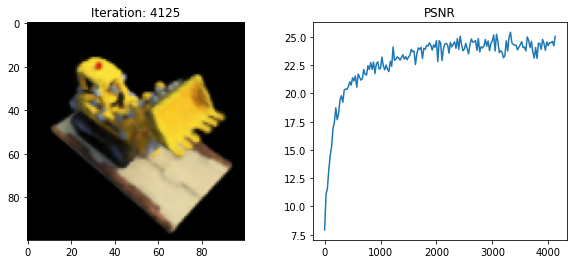

4150 0.462880277633667 secs per iter


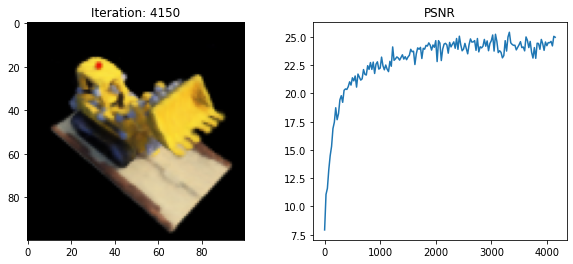

4175 0.4623936367034912 secs per iter


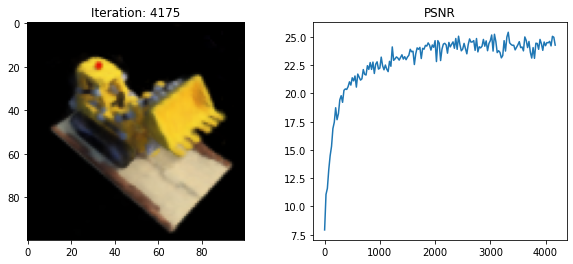

4200 0.4688298225402832 secs per iter


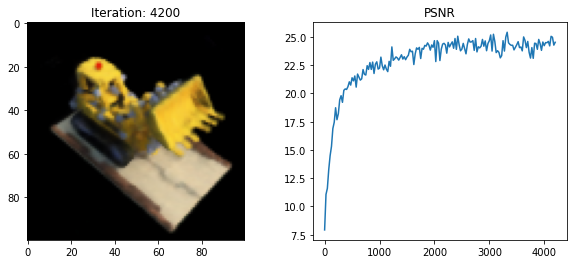

4225 0.4632845306396484 secs per iter


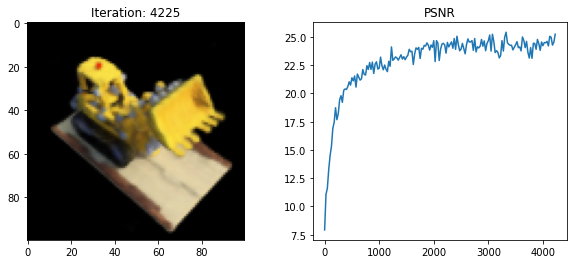

4250 0.46208867073059084 secs per iter


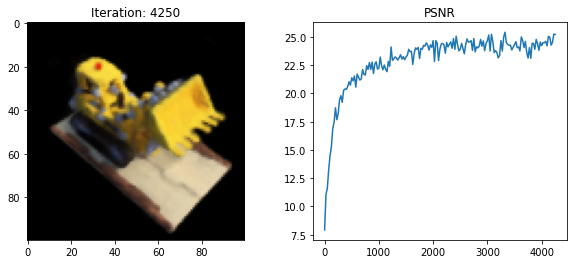

4275 0.46254452705383303 secs per iter


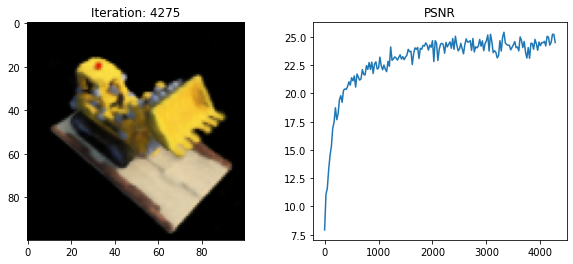

4300 0.4627662181854248 secs per iter


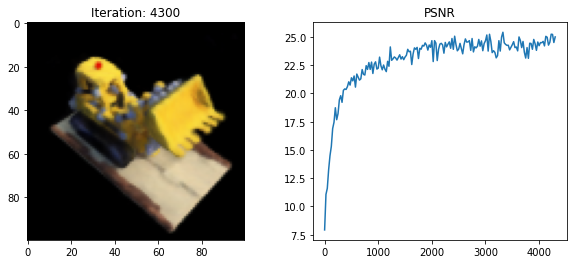

4325 0.46007078170776367 secs per iter


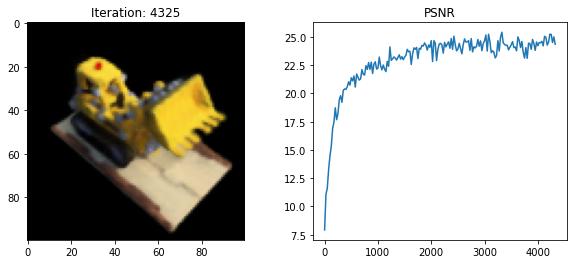

4350 0.45964612007141115 secs per iter


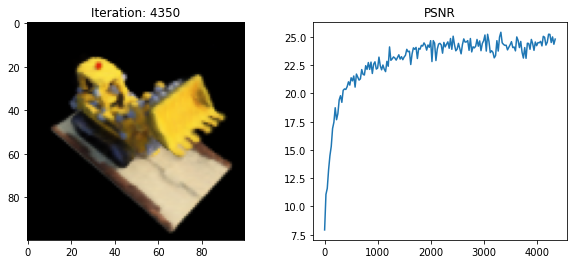

4375 0.46335032463073733 secs per iter


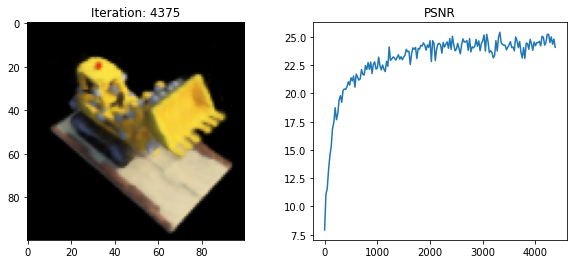

4400 0.46040848731994627 secs per iter


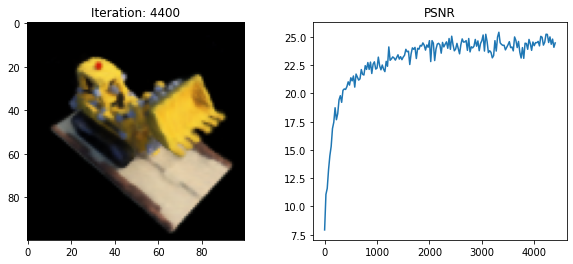

4425 0.46033289909362796 secs per iter


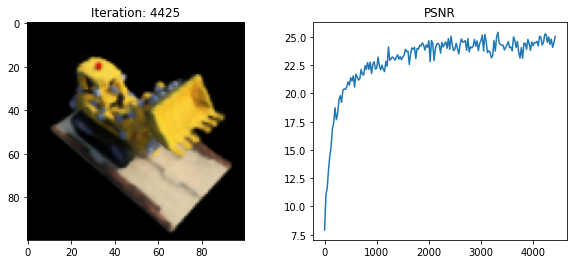

4450 0.4639767360687256 secs per iter


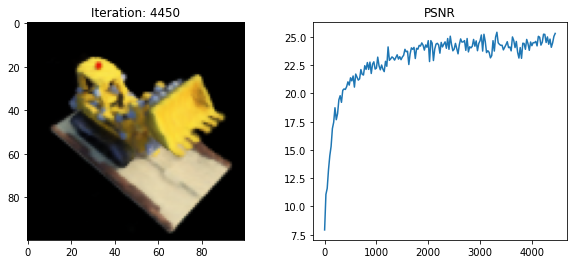

4475 0.4629864883422852 secs per iter


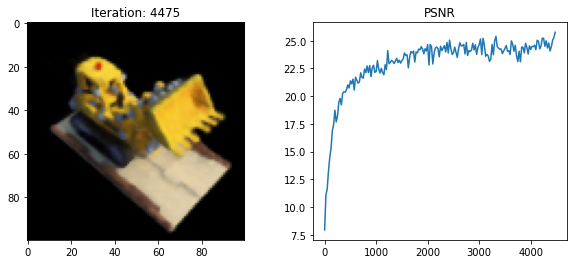

4500 0.4645070552825928 secs per iter


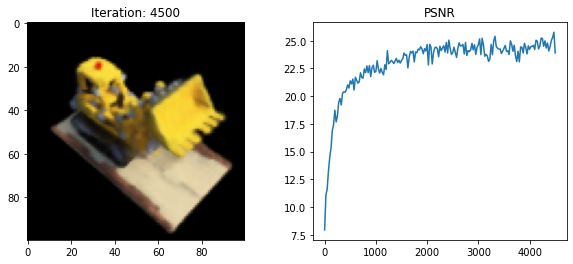

4525 0.4730644512176514 secs per iter


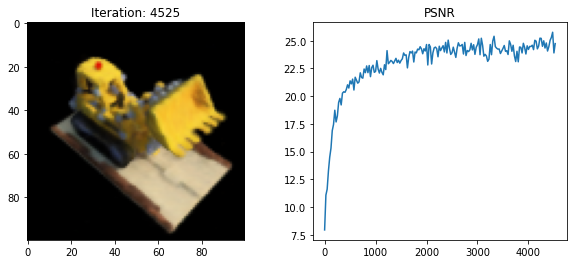

4550 0.45982598304748534 secs per iter


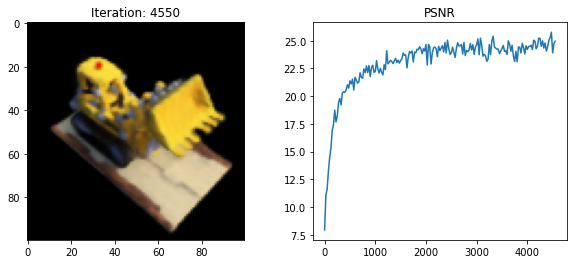

4575 0.46049384117126463 secs per iter


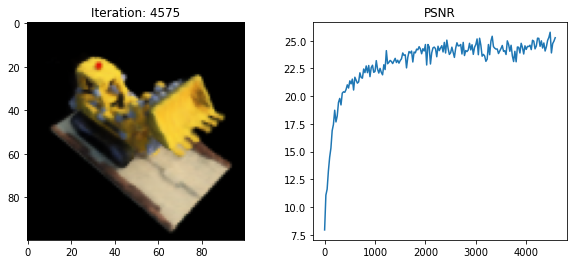

4600 0.46307150840759276 secs per iter


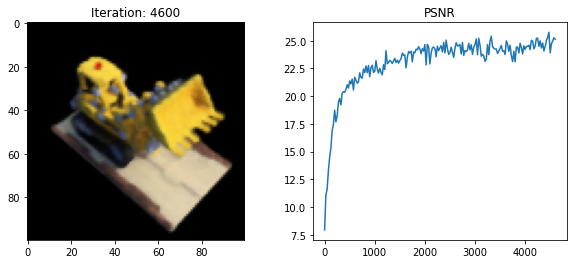

4625 0.4621220302581787 secs per iter


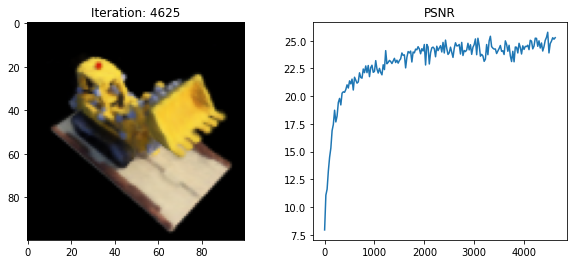

4650 0.46246101379394533 secs per iter


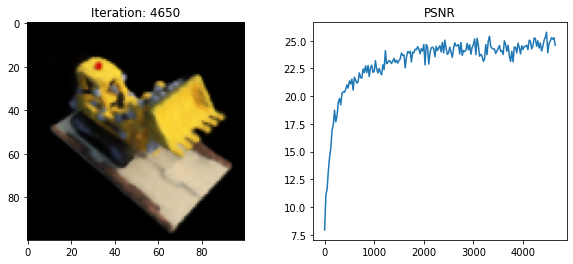

4675 0.46298709869384763 secs per iter


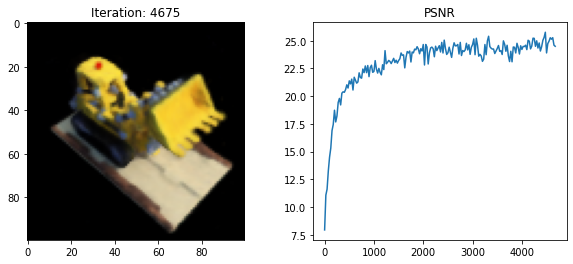

4700 0.4624430465698242 secs per iter


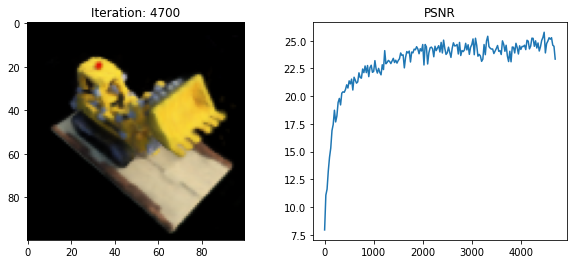

4725 0.46227478981018066 secs per iter


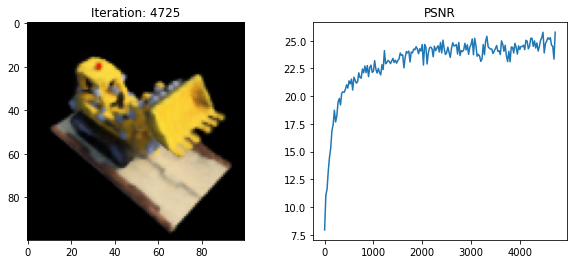

4750 0.4647686958312988 secs per iter


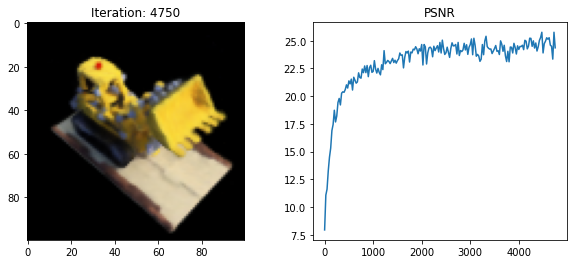

4775 0.46167579650878904 secs per iter


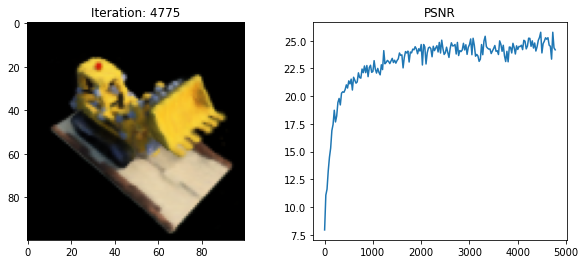

4800 0.4628365421295166 secs per iter


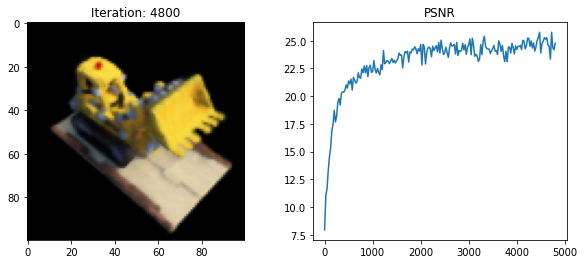

4825 0.46921887397766116 secs per iter


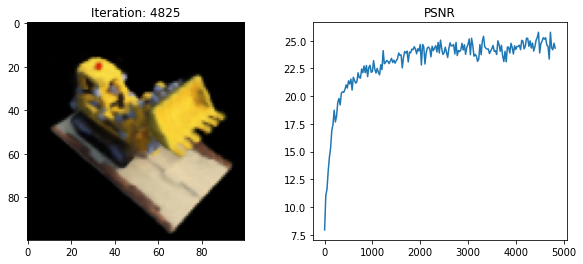

4850 0.46414731979370116 secs per iter


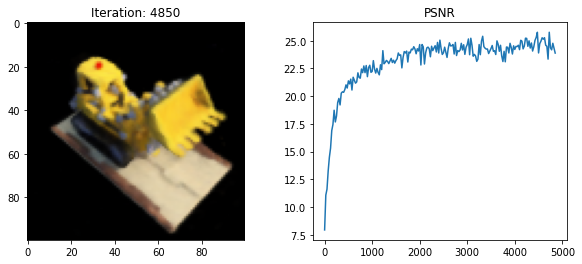

4875 0.4628197765350342 secs per iter


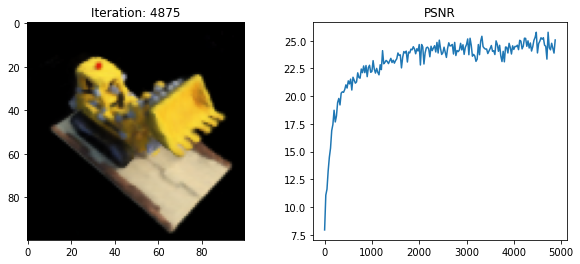

4900 0.4636113739013672 secs per iter


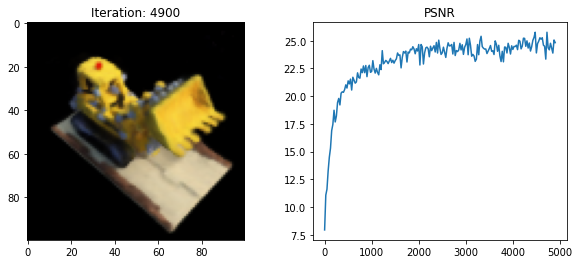

4925 0.4635643005371094 secs per iter


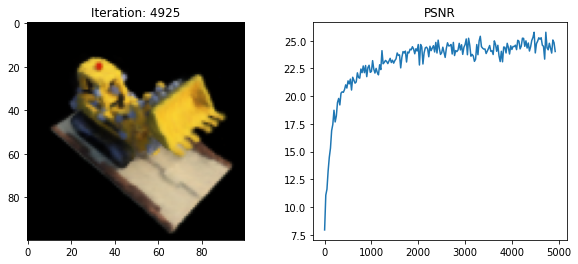

4950 0.4630210494995117 secs per iter


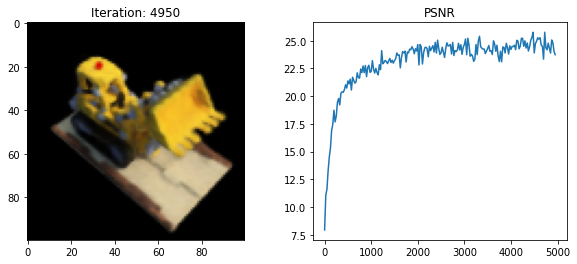

4975 0.46328028678894045 secs per iter


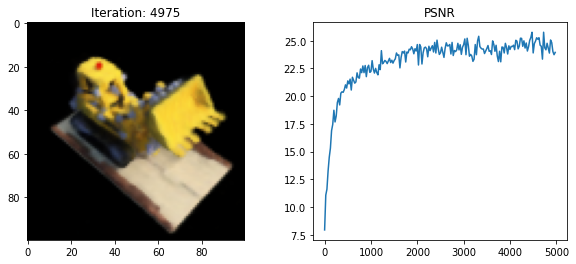

5000 0.46125288963317873 secs per iter


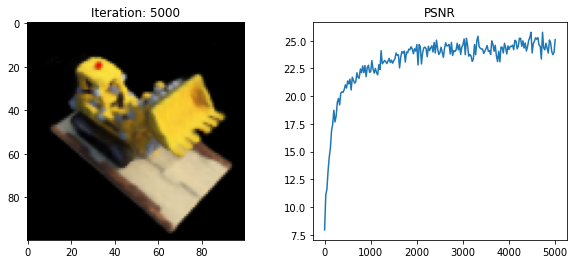

5025 0.46011982917785643 secs per iter


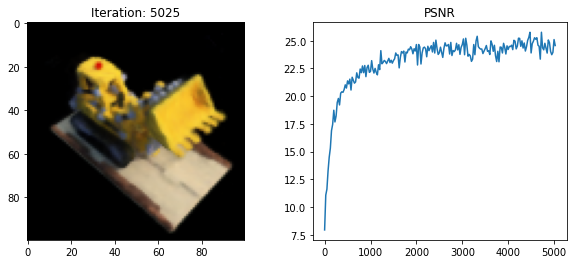

5050 0.4627338218688965 secs per iter


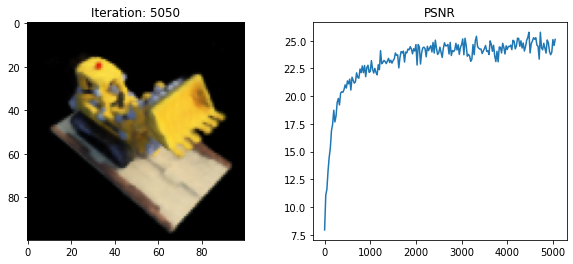

5075 0.46326111793518066 secs per iter


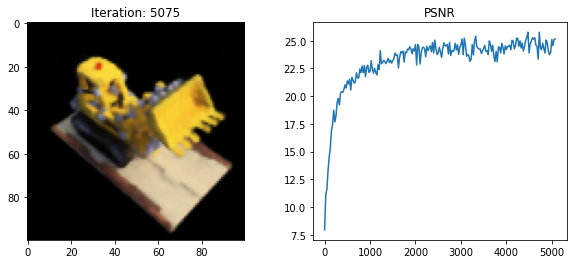

5100 0.46393169403076173 secs per iter


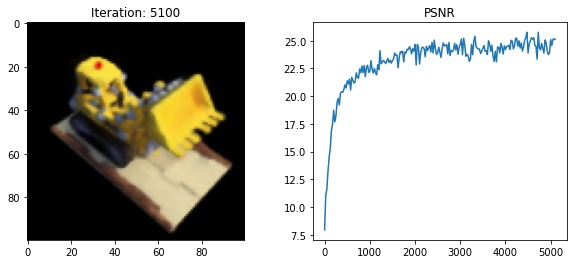

5125 0.4702472305297852 secs per iter


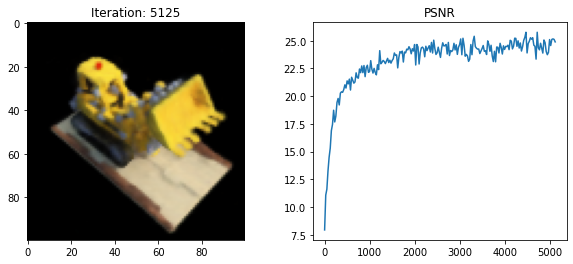

5150 0.4628786849975586 secs per iter


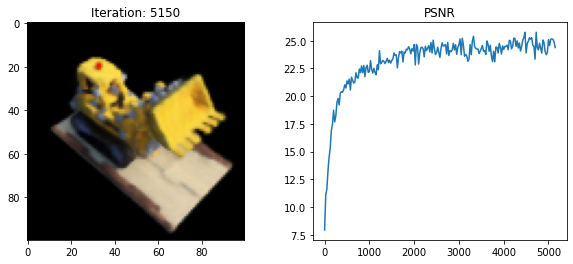

5175 0.46277895927429197 secs per iter


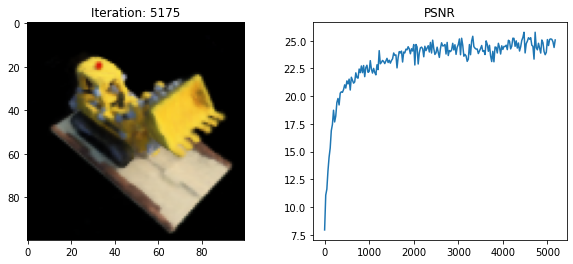

5200 0.46648316383361815 secs per iter


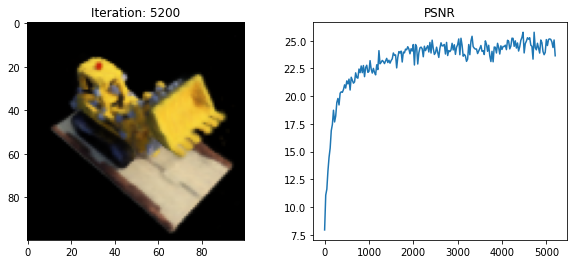

5225 0.46386936187744143 secs per iter


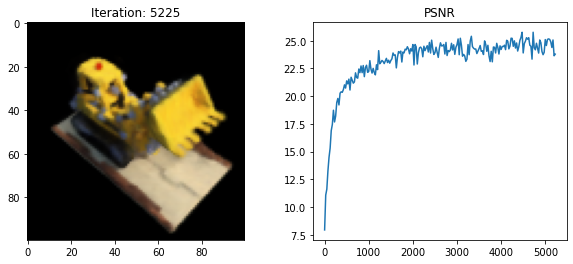

5250 0.4633205795288086 secs per iter


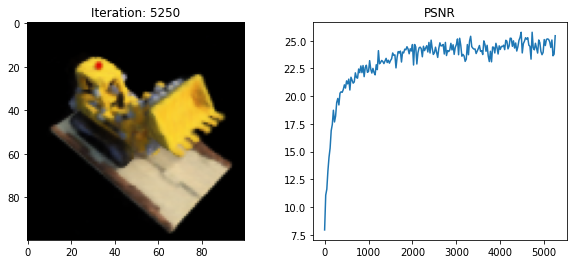

5275 0.463682279586792 secs per iter


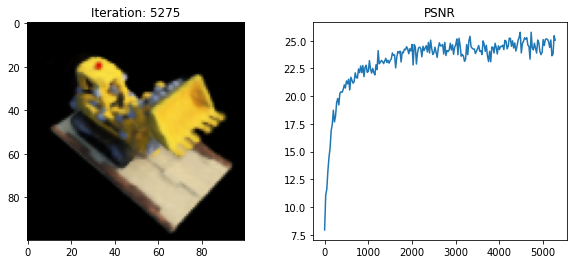

5300 0.4604953956604004 secs per iter


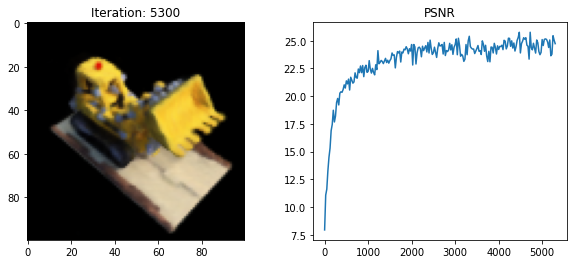

5325 0.46371888160705566 secs per iter


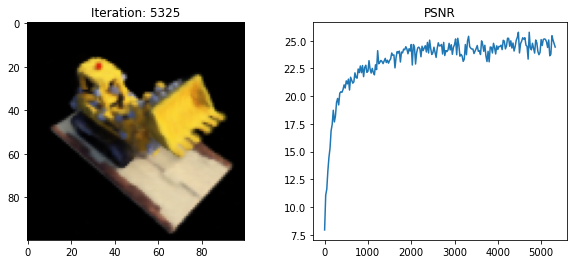

5350 0.4641484832763672 secs per iter


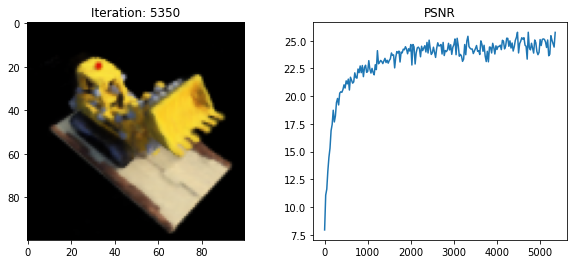

5375 0.46438032150268554 secs per iter


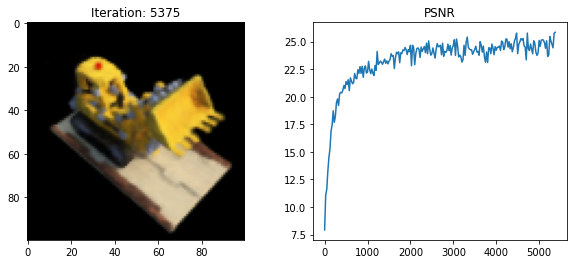

5400 0.4627265548706055 secs per iter


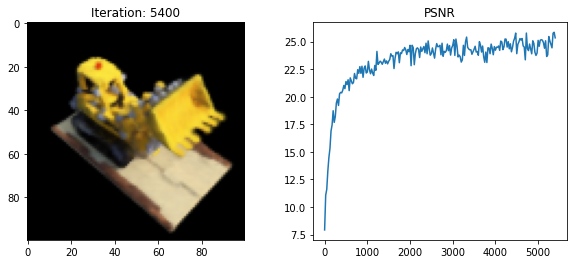

5425 0.471444787979126 secs per iter


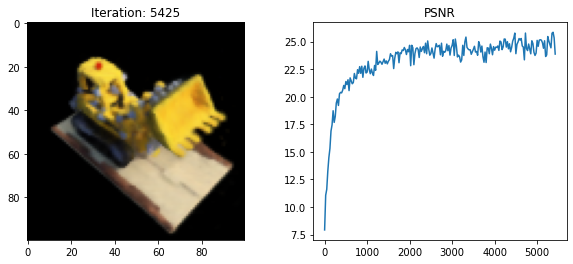

5450 0.4638935947418213 secs per iter


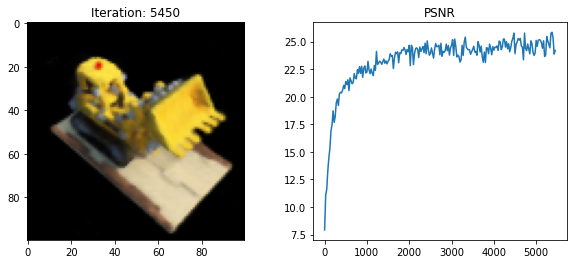

5475 0.46103471755981446 secs per iter


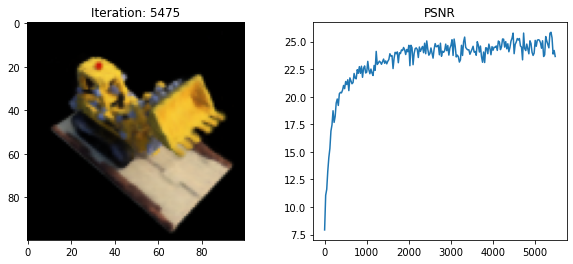

5500 0.46380895614624024 secs per iter


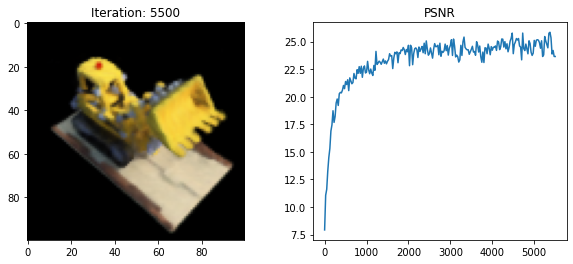

5525 0.46364965438842776 secs per iter


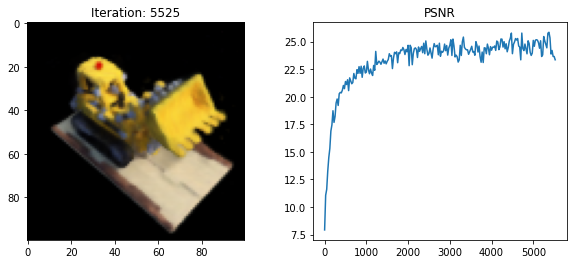

5550 0.46353983879089355 secs per iter


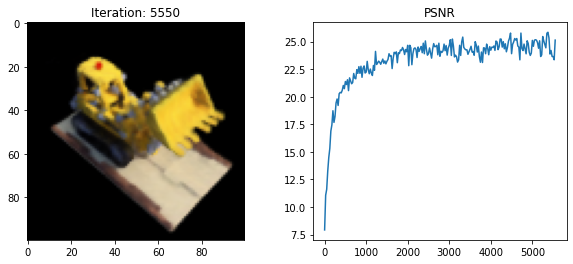

5575 0.4628154373168945 secs per iter


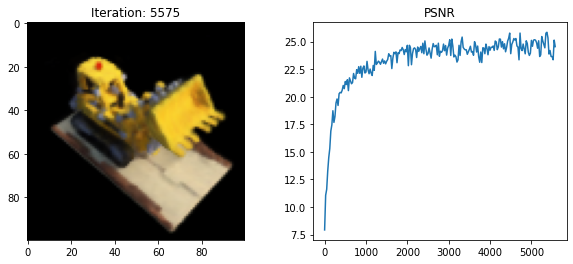

5600 0.46386241912841797 secs per iter


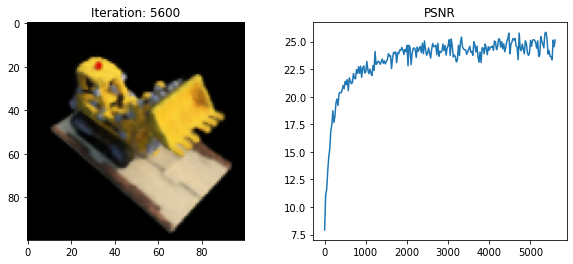

5625 0.46032470703125 secs per iter


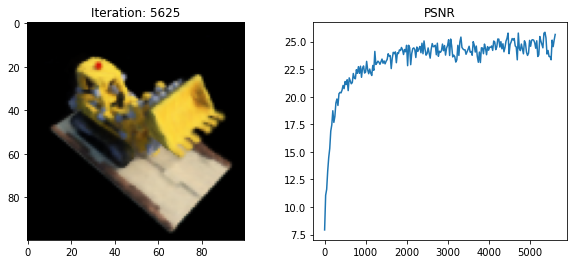

5650 0.4632358932495117 secs per iter


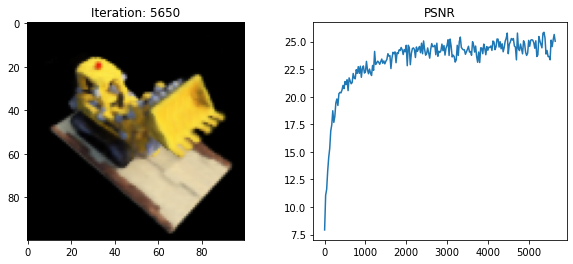

5675 0.4628214645385742 secs per iter


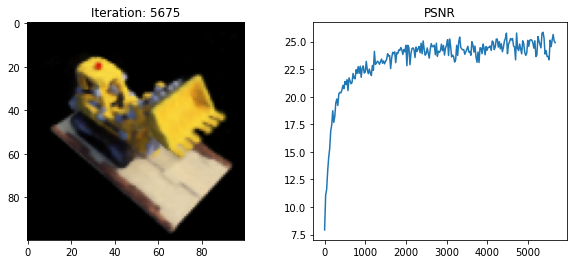

5700 0.4622958564758301 secs per iter


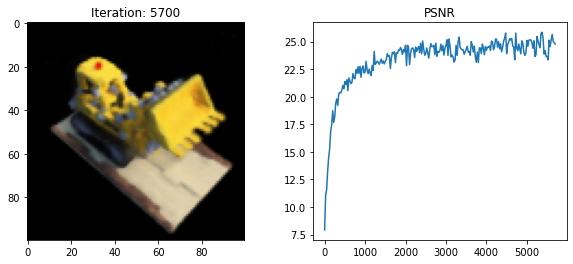

5725 0.4697987174987793 secs per iter


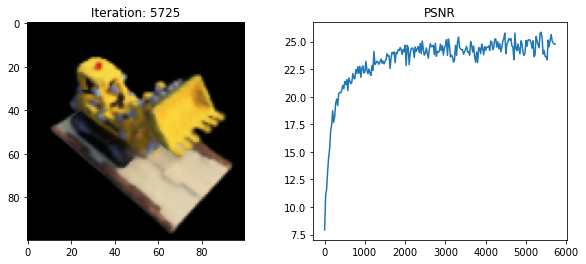

5750 0.46297091484069824 secs per iter


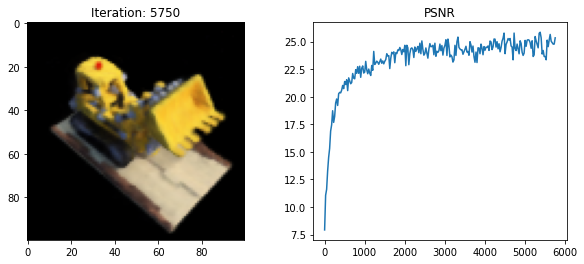

5775 0.4624783039093018 secs per iter


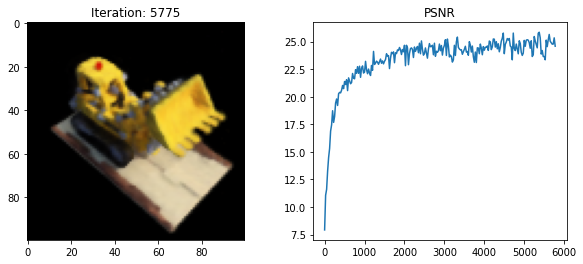

5800 0.46331143379211426 secs per iter


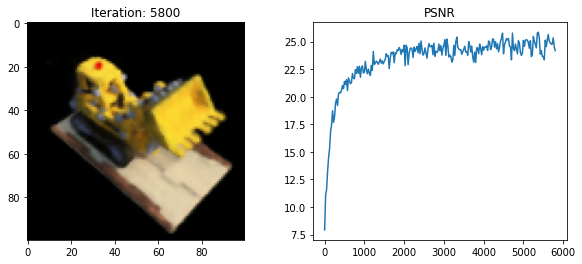

5825 0.46275403022766115 secs per iter


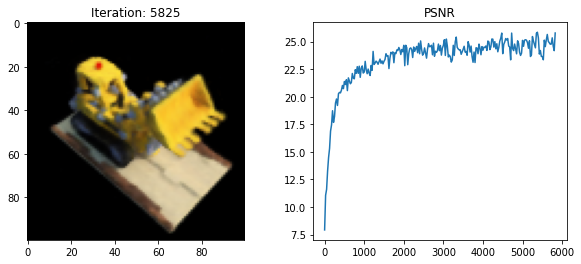

5850 0.4606259155273438 secs per iter


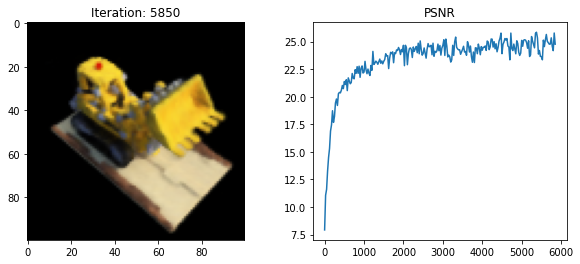

5875 0.4628849697113037 secs per iter


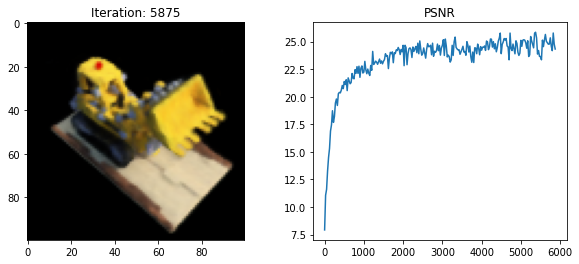

5900 0.4631640911102295 secs per iter


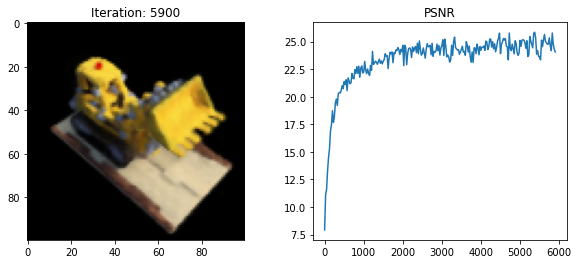

5925 0.46339113235473633 secs per iter


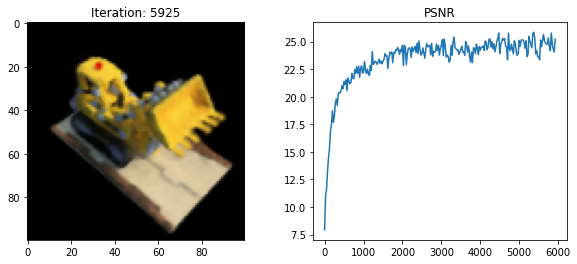

5950 0.4636504650115967 secs per iter


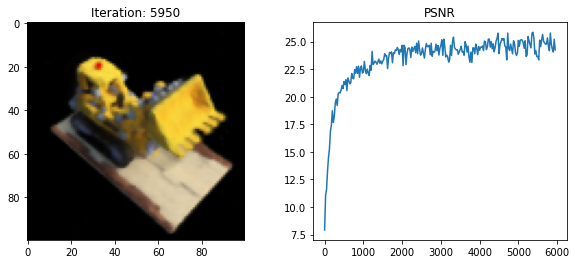

5975 0.4630879878997803 secs per iter


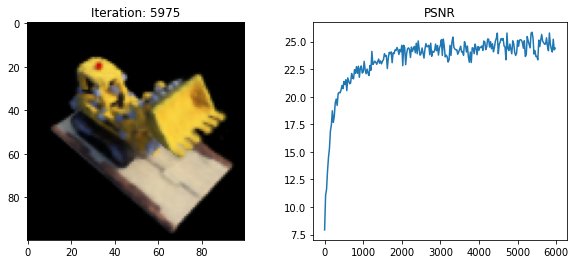

6000 0.46389763832092284 secs per iter


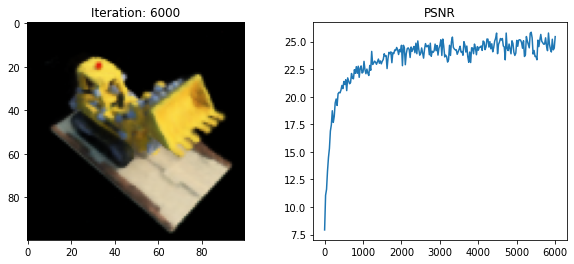

6025 0.4726395988464355 secs per iter


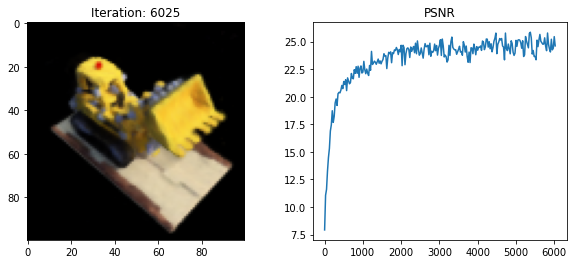

6050 0.4608346939086914 secs per iter


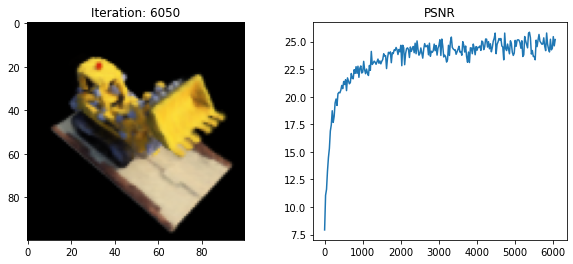

6075 0.46043423652648924 secs per iter


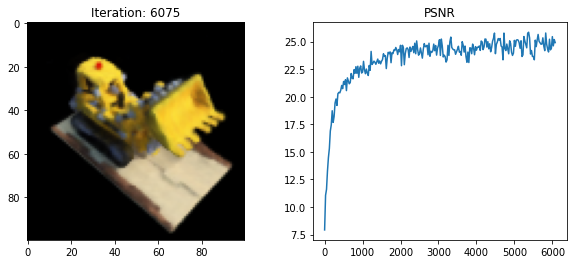

6100 0.463609504699707 secs per iter


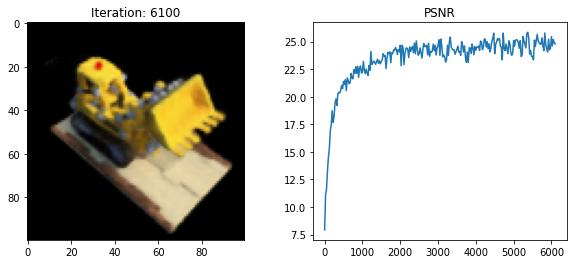

6125 0.46334381103515626 secs per iter


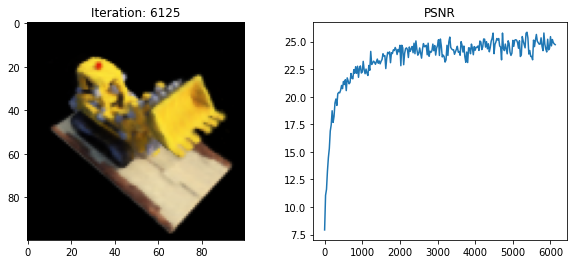

6150 0.46051513671875 secs per iter


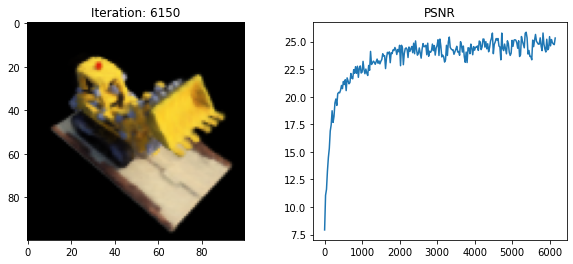

6175 0.4633702087402344 secs per iter


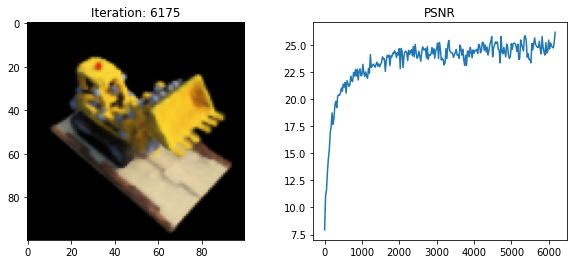

6200 0.4645434093475342 secs per iter


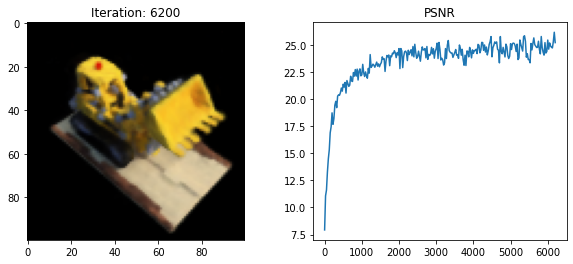

6225 0.4631251335144043 secs per iter


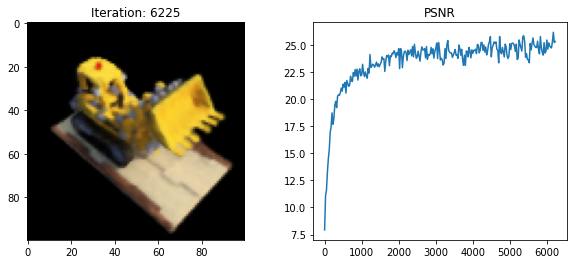

6250 0.463455867767334 secs per iter


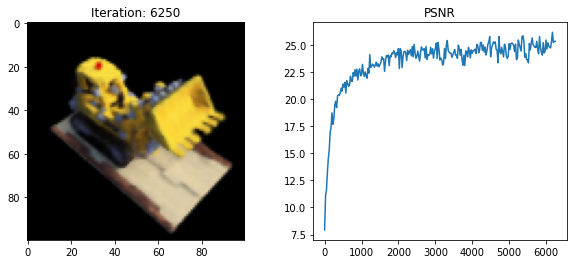

6275 0.4634835720062256 secs per iter


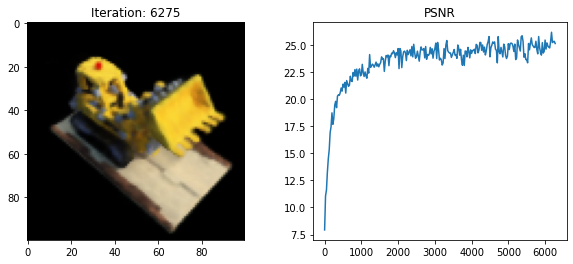

6300 0.4633621120452881 secs per iter


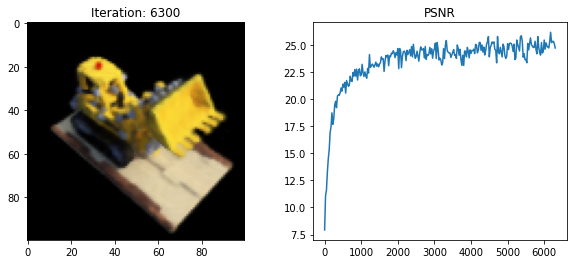

6325 0.4699974346160889 secs per iter


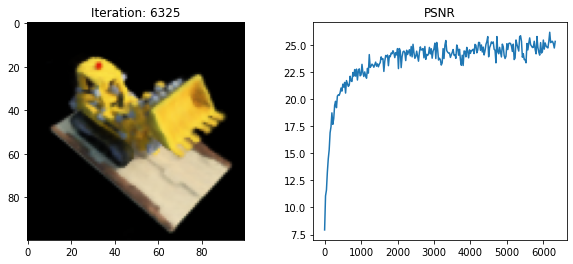

6350 0.4635137462615967 secs per iter


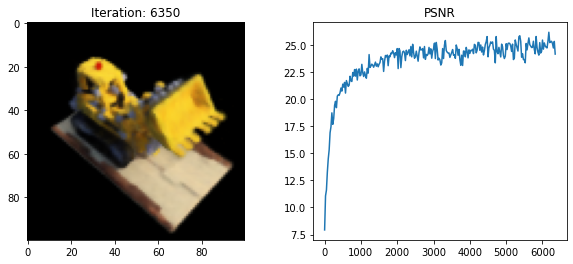

6375 0.46285531044006345 secs per iter


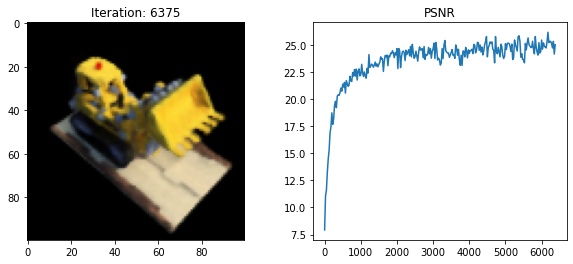

6400 0.46390547752380373 secs per iter


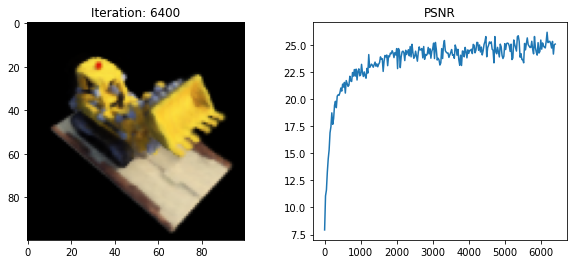

6425 0.46276883125305174 secs per iter


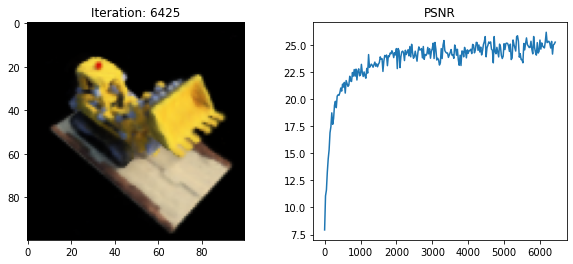

6450 0.46322815895080566 secs per iter


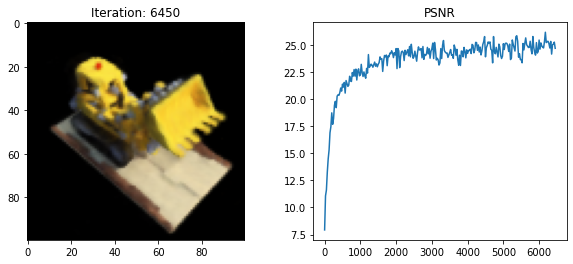

6475 0.46379963874816893 secs per iter


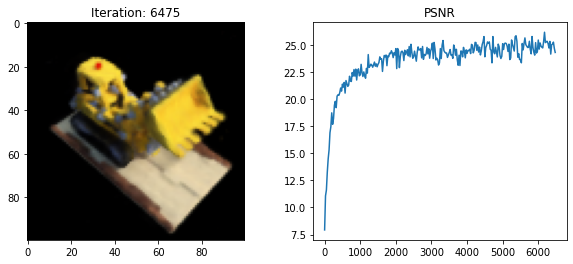

6500 0.46327954292297363 secs per iter


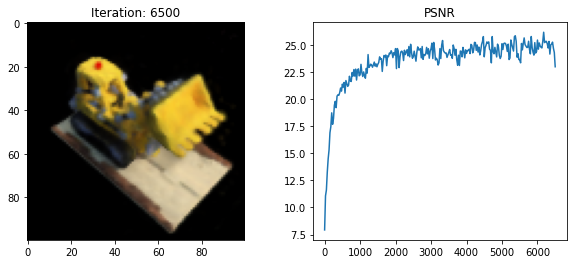

6525 0.46294288635253905 secs per iter


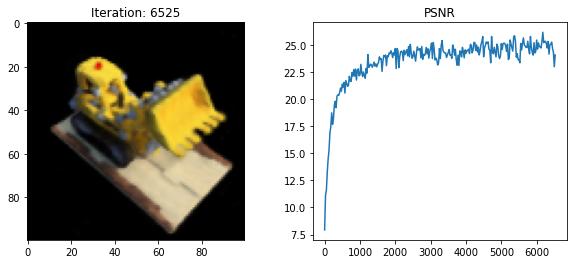

6550 0.46357958793640136 secs per iter


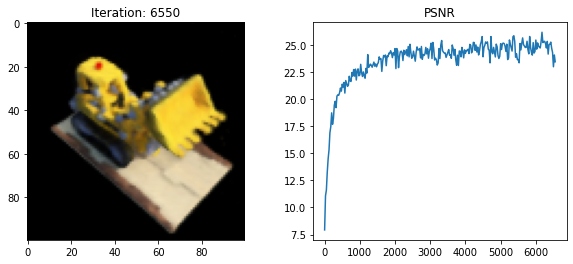

6575 0.4627469253540039 secs per iter


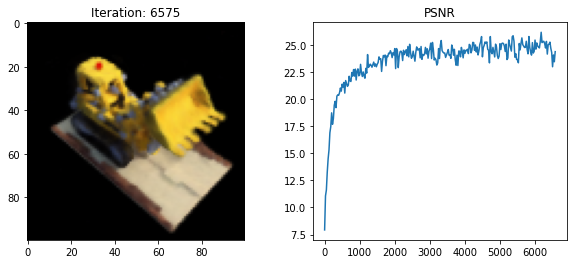

6600 0.46342169761657714 secs per iter


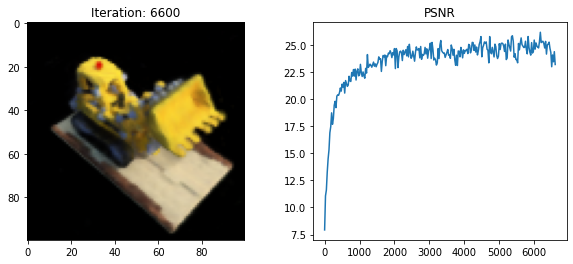

6625 0.47062091827392577 secs per iter


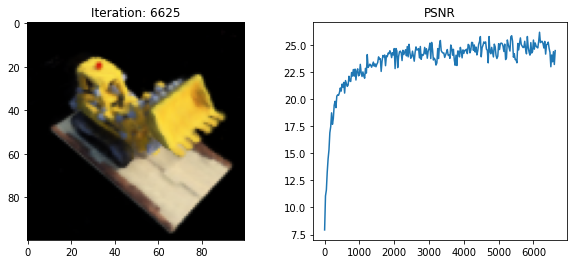

6650 0.4636697006225586 secs per iter


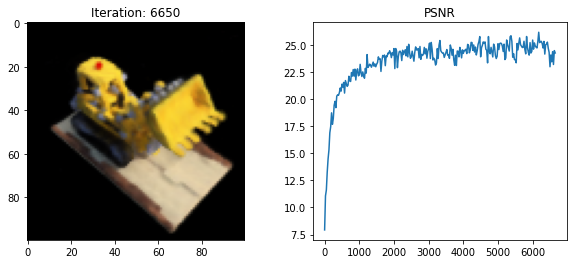

6675 0.46319849967956545 secs per iter


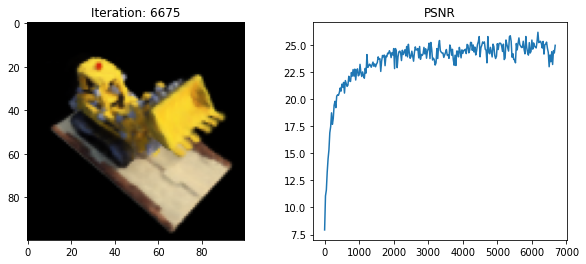

6700 0.4637280368804932 secs per iter


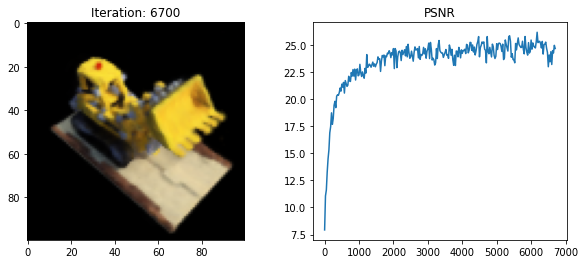

6725 0.462545108795166 secs per iter


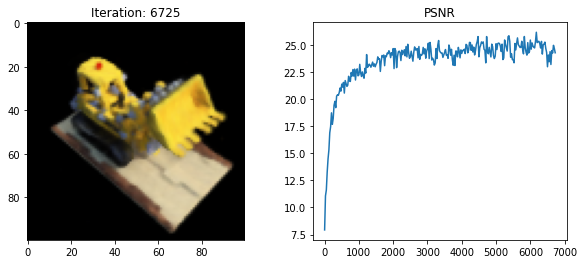

6750 0.4631539535522461 secs per iter


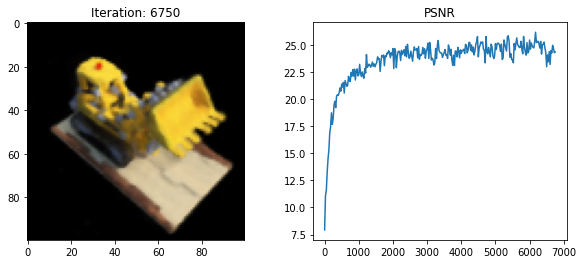

6775 0.4631676197052002 secs per iter


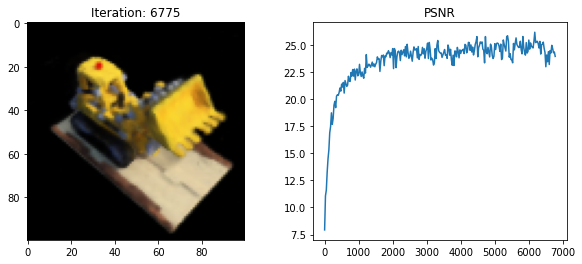

6800 0.4634544277191162 secs per iter


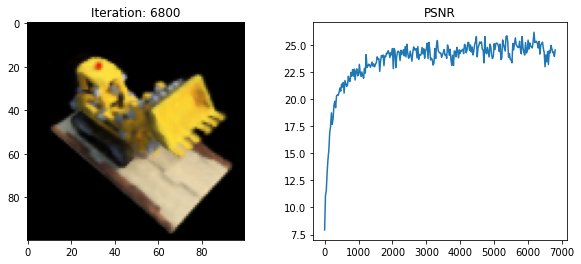

6825 0.46370485305786135 secs per iter


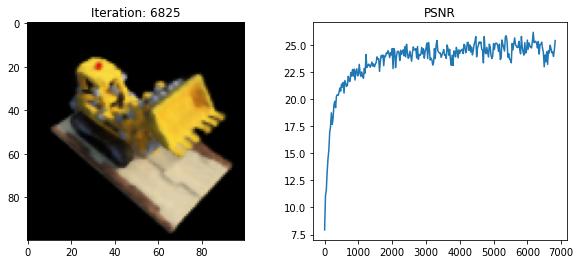

6850 0.46295771598815916 secs per iter


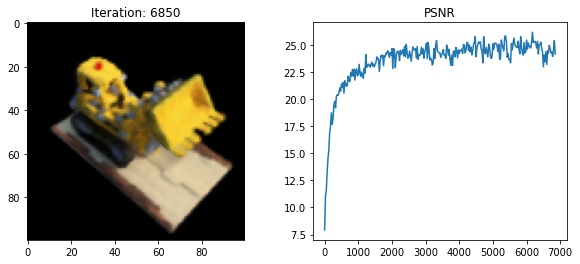

6875 0.4631168174743652 secs per iter


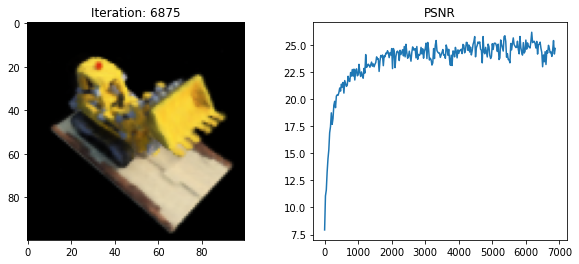

6900 0.46315589904785154 secs per iter


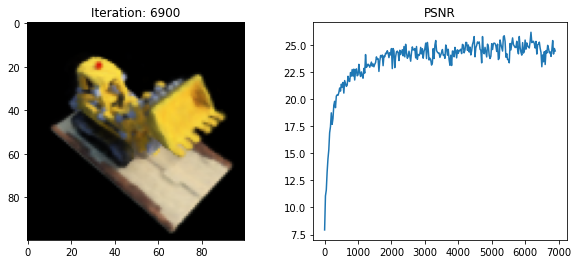

6925 0.47053898811340333 secs per iter


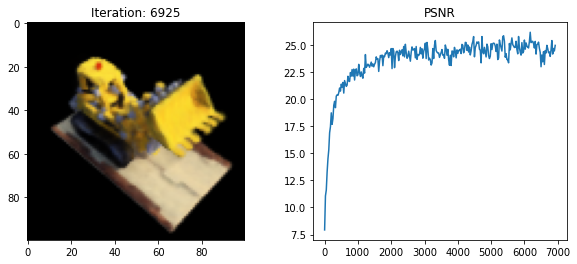

6950 0.463165340423584 secs per iter


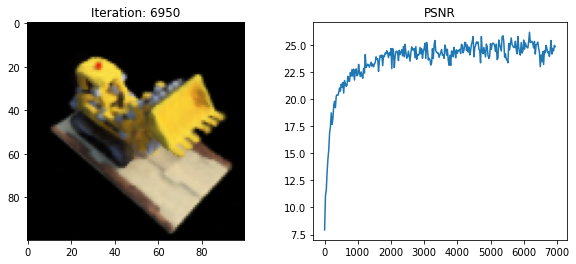

6975 0.46270322799682617 secs per iter


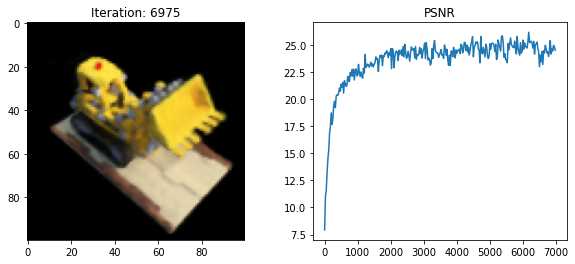

7000 0.46379531860351564 secs per iter


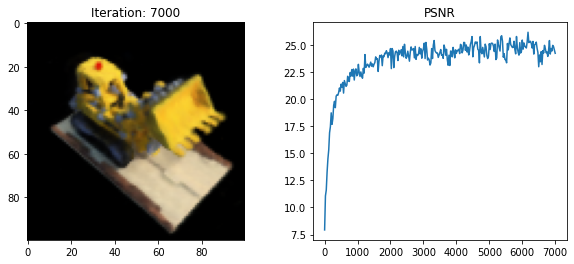

7025 0.4634101104736328 secs per iter


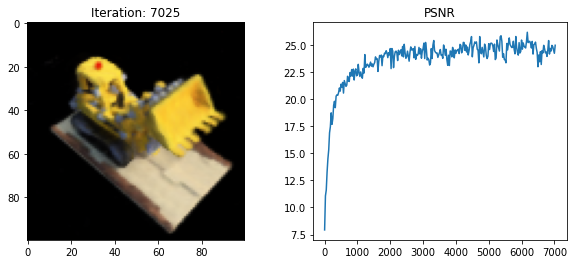

7050 0.46316744804382326 secs per iter


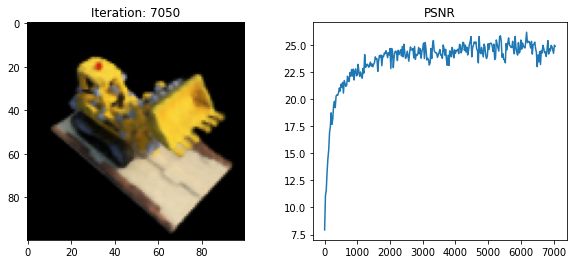

7075 0.4646693515777588 secs per iter


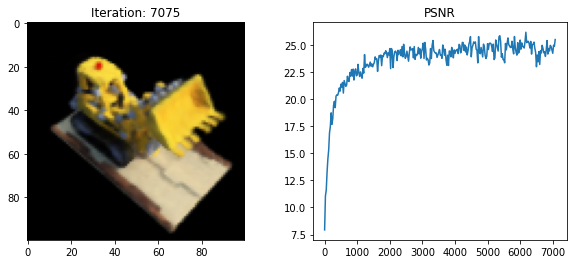

7100 0.4635010719299316 secs per iter


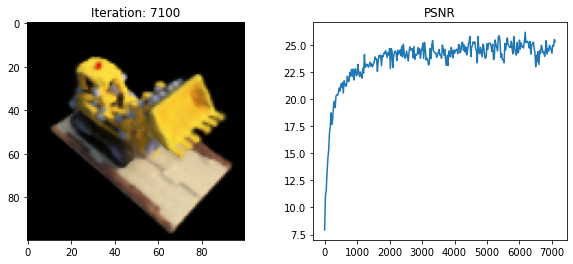

7125 0.4627590370178223 secs per iter


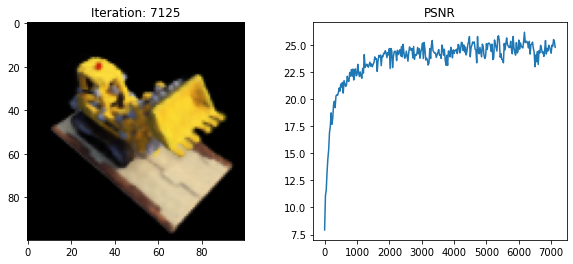

7150 0.46331416130065917 secs per iter


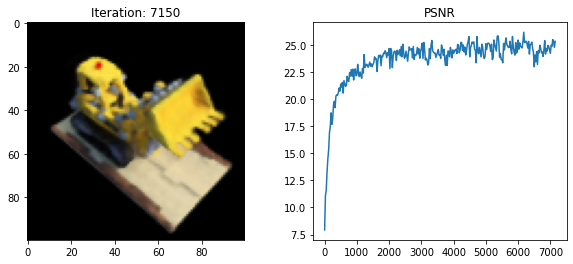

7175 0.46300874710083006 secs per iter


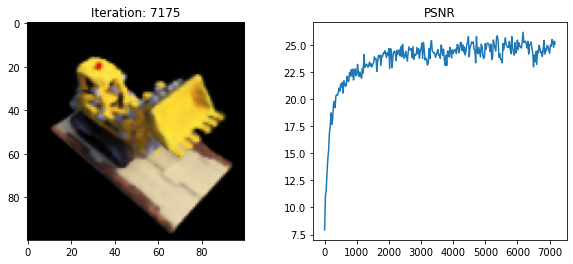

7200 0.4634060192108154 secs per iter


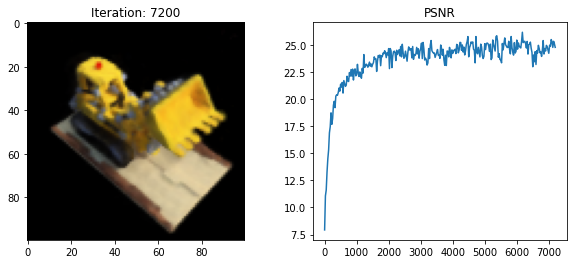

7225 0.4706091022491455 secs per iter


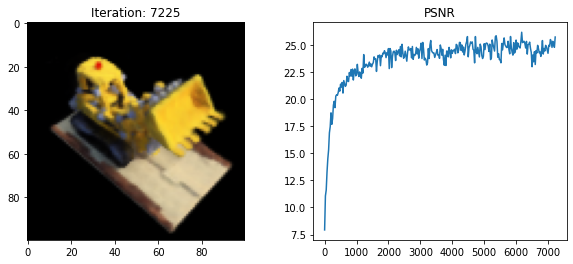

7250 0.46319649696350096 secs per iter


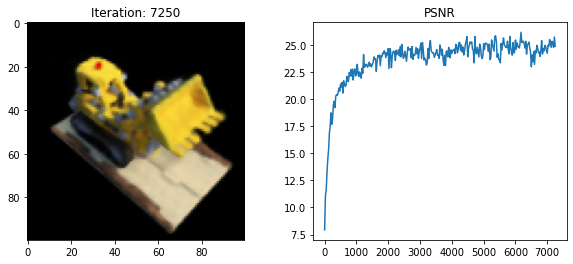

7275 0.46414878845214846 secs per iter


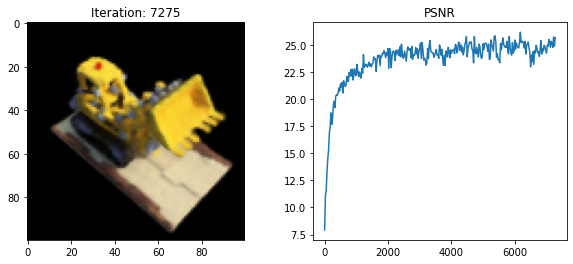

7300 0.46287525177001954 secs per iter


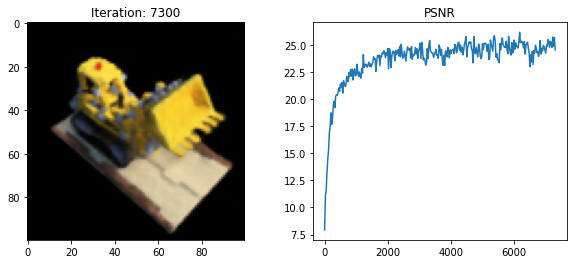

7325 0.46372146606445314 secs per iter


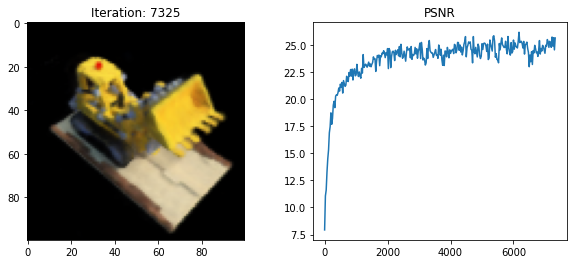

7350 0.46270774841308593 secs per iter


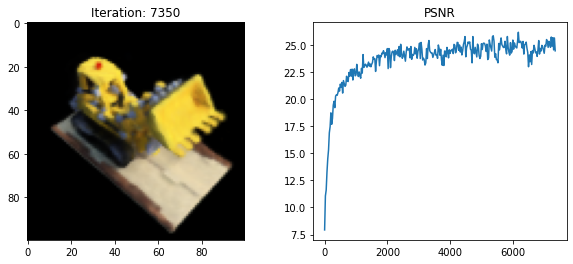

7375 0.46278498649597166 secs per iter


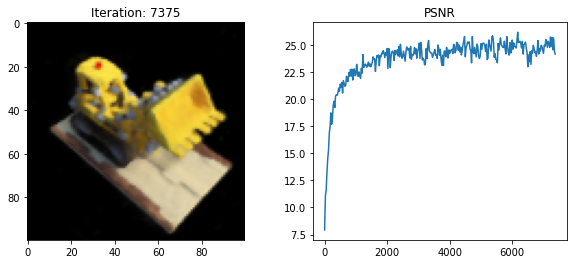

7400 0.4596633529663086 secs per iter


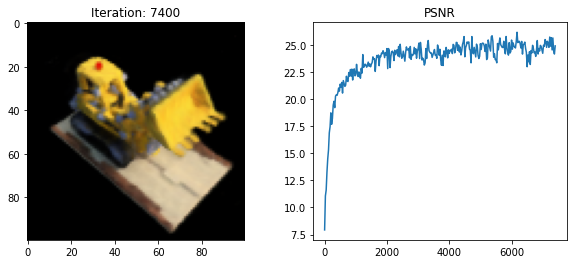

7425 0.46322141647338866 secs per iter


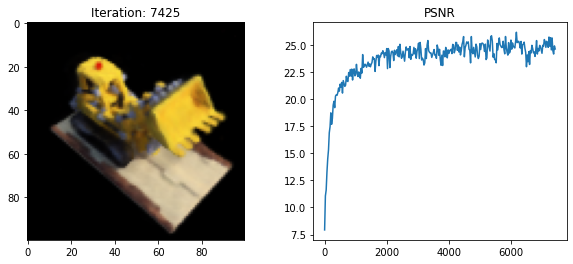

7450 0.4624085140228271 secs per iter


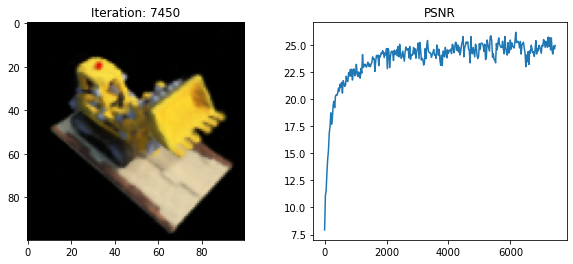

7475 0.46250276565551757 secs per iter


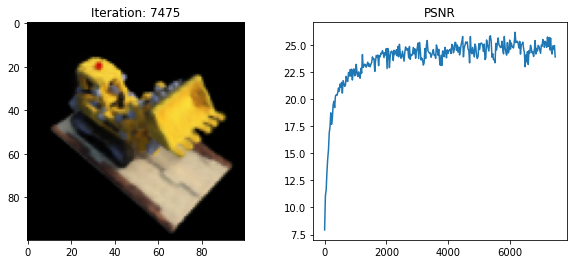

7500 0.4619638156890869 secs per iter


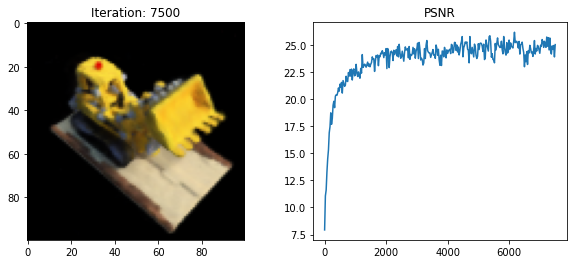

7525 0.4620285797119141 secs per iter


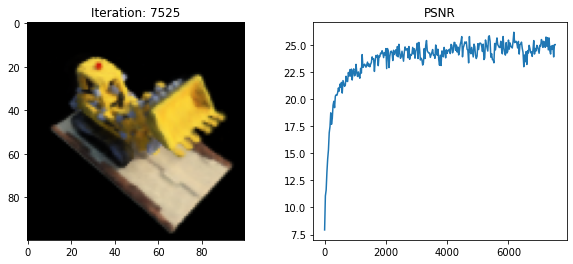

7550 0.4692509651184082 secs per iter


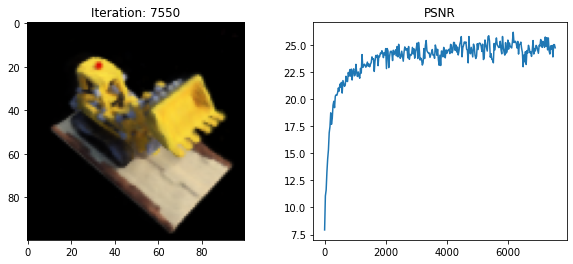

7575 0.4632271671295166 secs per iter


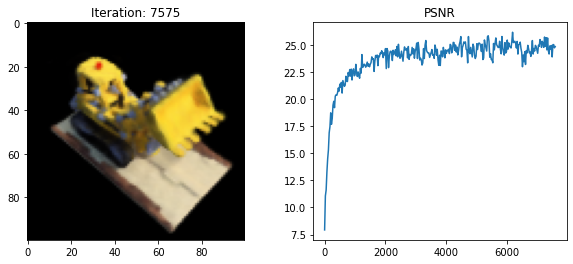

7600 0.4630634117126465 secs per iter


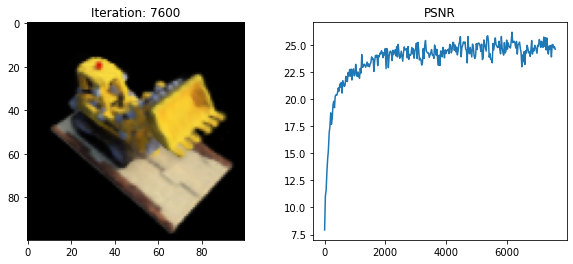

7625 0.4599620532989502 secs per iter


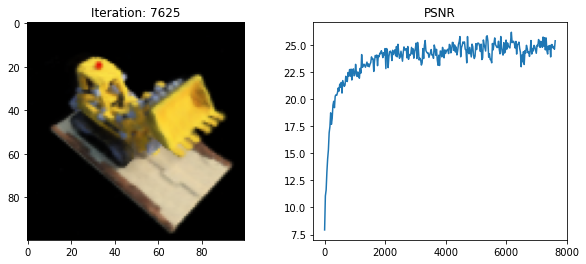

7650 0.4596092224121094 secs per iter


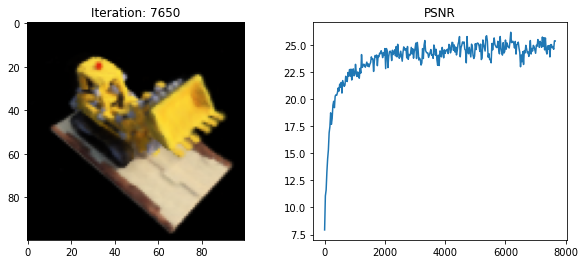

7675 0.4636983585357666 secs per iter


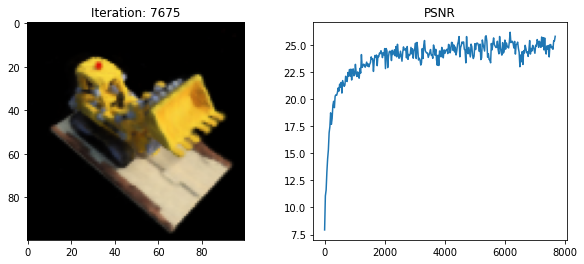

7700 0.4609927463531494 secs per iter


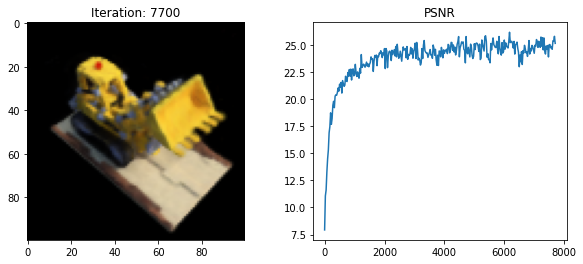

7725 0.46271093368530275 secs per iter


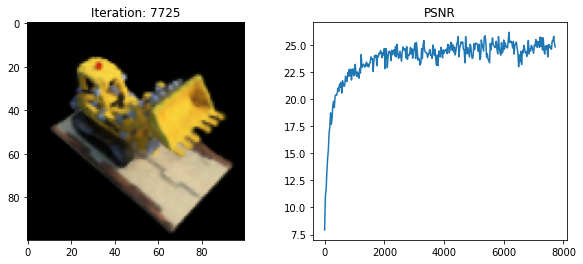

7750 0.46284899711608884 secs per iter


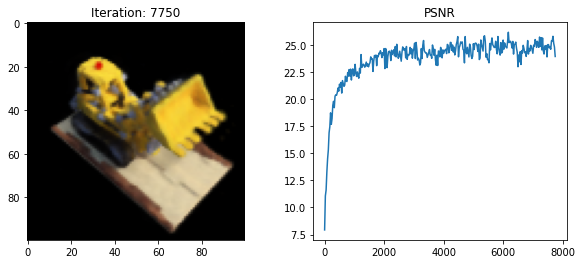

7775 0.4602175998687744 secs per iter


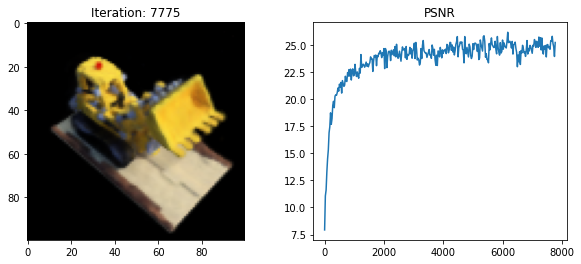

7800 0.4624083614349365 secs per iter


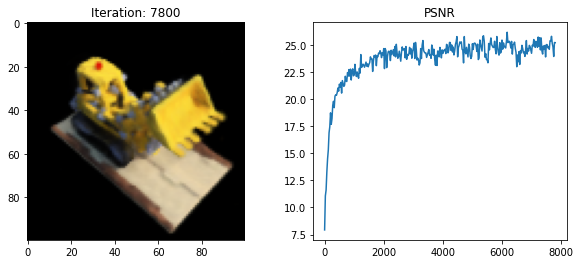

7825 0.462878475189209 secs per iter


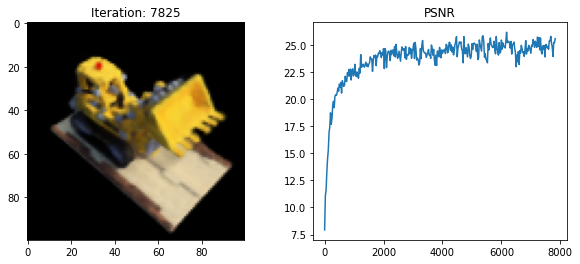

7850 0.46894392013549807 secs per iter


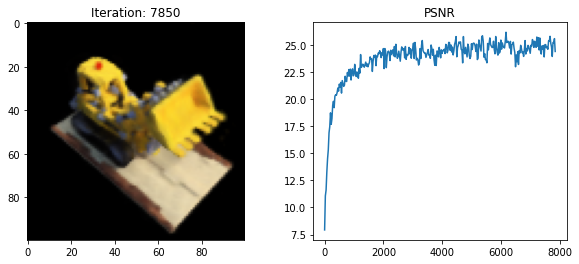

7875 0.4624925708770752 secs per iter


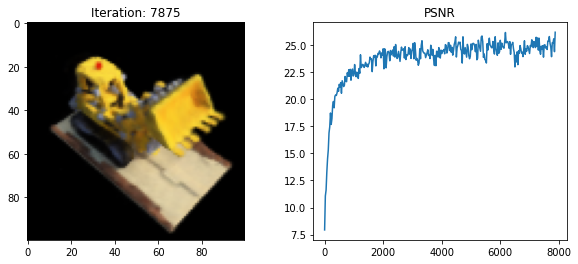

7900 0.4647948741912842 secs per iter


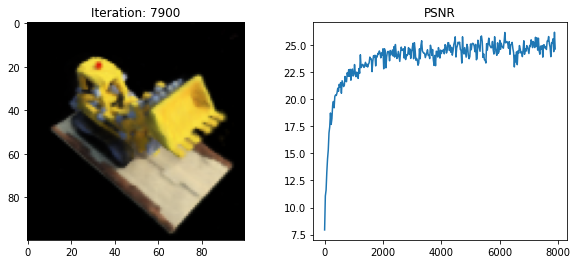

7925 0.460603141784668 secs per iter


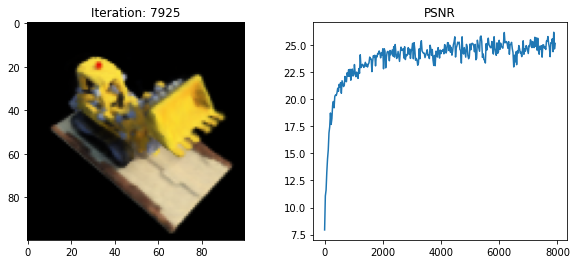

7950 0.46234472274780275 secs per iter


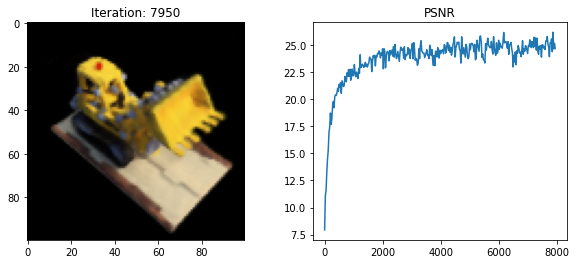

7975 0.4641667652130127 secs per iter


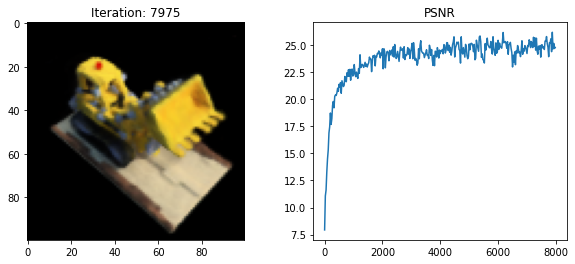

8000 0.46237778663635254 secs per iter


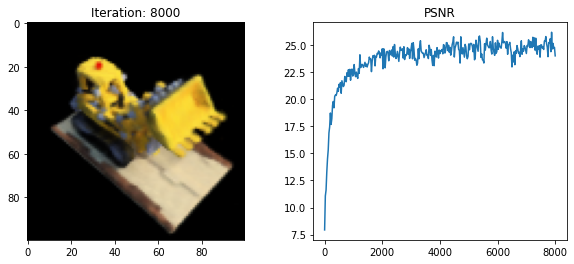

Done


In [6]:
model = init_model()
optimizer = tf.keras.optimizers.Adam(5e-4)

checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(optimizer=optimizer, model=model)

N_samples = 64
N_iters = 8000
psnrs = []
iternums = []
i_plot = 25

best_psnr = -float('inf')

import time
t = time.time()
for i in range(N_iters+1):
    
    img_i = np.random.randint(images.shape[0])
    target = images[img_i]
    pose = poses[img_i]
    rays_o, rays_d = get_rays(H, W, focal, pose)
    with tf.GradientTape() as tape:
        rgb, depth, acc = render_rays(model, rays_o, rays_d, near=2., far=6., N_samples=N_samples, rand=True)
        loss = tf.reduce_mean(tf.square(rgb - target))
    gradients = tape.gradient(loss, model.trainable_variables)
    optimizer.apply_gradients(zip(gradients, model.trainable_variables))
    
    if i%i_plot==0:
        print(i, (time.time() - t) / i_plot, 'secs per iter')
        t = time.time()
        
        # Render the holdout view for logging
        rays_o, rays_d = get_rays(H, W, focal, testpose)
        rgb, depth, acc = render_rays(model, rays_o, rays_d, near=2., far=6., N_samples=N_samples)
        loss = tf.reduce_mean(tf.square(rgb - testimg))
        psnr = -10. * tf.math.log(loss) / tf.math.log(10.)
        
        # save the best
        if psnr > best_psnr:
            best_psnr = psnr
            checkpoint.save(file_prefix = checkpoint_prefix)

        psnrs.append(psnr.numpy())
        iternums.append(i)
        
        plt.figure(figsize=(10,4))
        plt.subplot(121)
        plt.imshow(rgb)
        plt.title(f'Iteration: {i}')
        plt.subplot(122)
        plt.plot(iternums, psnrs)
        plt.title('PSNR')
        plt.show()

print('Done')

# Interactive Visualization

In [7]:
%matplotlib inline
from ipywidgets import interactive, widgets


trans_t = lambda t : tf.convert_to_tensor([
    [1,0,0,0],
    [0,1,0,0],
    [0,0,1,t],
    [0,0,0,1],
], dtype=tf.float32)

rot_phi = lambda phi : tf.convert_to_tensor([
    [1,0,0,0],
    [0,tf.cos(phi),-tf.sin(phi),0],
    [0,tf.sin(phi), tf.cos(phi),0],
    [0,0,0,1],
], dtype=tf.float32)

rot_theta = lambda th : tf.convert_to_tensor([
    [tf.cos(th),0,-tf.sin(th),0],
    [0,1,0,0],
    [tf.sin(th),0, tf.cos(th),0],
    [0,0,0,1],
], dtype=tf.float32)


def pose_spherical(theta, phi, radius):
    c2w = trans_t(radius)
    c2w = rot_phi(phi/180.*np.pi) @ c2w
    c2w = rot_theta(theta/180.*np.pi) @ c2w
    c2w = np.array([[-1,0,0,0],[0,0,1,0],[0,1,0,0],[0,0,0,1]]) @ c2w
    return c2w


def f(**kwargs):
    c2w = pose_spherical(**kwargs)
    rays_o, rays_d = get_rays(H, W, focal, c2w[:3,:4])
    rgb, depth, acc = render_rays(model, rays_o, rays_d, near=2., far=6., N_samples=N_samples)
    img = np.clip(rgb,0,1)
    
    plt.figure(2, figsize=(20,6))
    plt.imshow(img)
    plt.show()
    

sldr = lambda v, mi, ma: widgets.FloatSlider(
    value=v,
    min=mi,
    max=ma,
    step=.01,
)

names = [
    ['theta', [100., 0., 360]],
    ['phi', [-30., -90, 0]],
    ['radius', [4., 3., 5.]],
]

interactive_plot = interactive(f, **{s[0] : sldr(*s[1]) for s in names})
output = interactive_plot.children[-1]
output.layout.height = '350px'
interactive_plot

interactive(children=(FloatSlider(value=100.0, description='theta', max=360.0, step=0.01), FloatSlider(value=-…

# Render 360 Video

In [8]:
frames = []
for th in tqdm(np.linspace(0., 360., 120, endpoint=False)):
    c2w = pose_spherical(th, -30., 4.)
    rays_o, rays_d = get_rays(H, W, focal, c2w[:3,:4])
    rgb, depth, acc = render_rays(model, rays_o, rays_d, near=2., far=6., N_samples=N_samples)
    frames.append((255*np.clip(rgb,0,1)).astype(np.uint8))

import imageio
f = 'video.mp4'
imageio.mimwrite(f, frames, fps=30, quality=7)

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:2: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  


  0%|          | 0/120 [00:00<?, ?it/s]

[swscaler @ 0x65753c0] Warning: data is not aligned! This can lead to a speed loss


In [9]:
from IPython.display import HTML
from base64 import b64encode
mp4 = open('video.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls autoplay loop>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)